# Import and settings

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.pyplot import rc_context
from multiprocessing import Pool
sc.settings.verbosity = 1

#sc.logging.print_versions()

import os 
import sys
import gc
import importlib

plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['font.sans-serif'] = 'Arial'
sc.set_figure_params(dpi=50, dpi_save=300, vector_friendly=True)
sns.set_style('white', {'axes.grid' : False})

sys.path.append('/home/lee/project/scanpy_func/')

import scanpy_func as sf
# import spatialSNV as ss

def vector(on=False):
    if on:
        sc.set_figure_params(dpi=50, dpi_save=300, vector_friendly=False)
    else:
        sc.set_figure_params(dpi=50, dpi_save=300, vector_friendly=True)
vector(False)

In [ ]:
def sc_qc(adata, min_genes=0, max_genes=0, mt_pct=0, min_cells=0, sc_cal=True, sc_filter=True):
    if sc_cal:
        adata.var['mt'] = adata.var_names.str.startswith('mt-')
        adata.var['rp'] = adata.var_names.str.startswith('Rpl') | adata.var_names.str.startswith('Rps')
        if adata.var['mt'].sum() == 0:
            adata.var['mt'] = adata.var_names.str.startswith('MT-')
            adata.var['rp'] = adata.var_names.str.startswith('RPL') | adata.var_names.str.startswith('RPS')
        sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)
        sc.pp.calculate_qc_metrics(adata, qc_vars=['rp'], percent_top=None, log1p=False, inplace=True)
        
    if sc_filter:
        if min_genes > 0:
            sc.pp.filter_cells(adata, min_genes=min_genes)
        if max_genes > 0:
            sc.pp.filter_cells(adata, max_genes=max_genes)
        
        if mt_pct > 0:    
            adata = adata[adata.obs.pct_counts_mt <= mt_pct, :]
        if min_cells > 0:
            sc.pp.filter_genes(adata, min_cells=min_cells)
    
    return adata

def del_mt_rp(adata):
    var_names = adata.var_names[~(adata.var['mt'] | adata.var['rp'])]
    var_names = var_names[~var_names.isin([x for x in var_names if '.' in x])]
    return adata[:, var_names]

def reloc(adata, arrange='v', cat=None):
    loc = pd.DataFrame(adata.obsm['spatial'], columns=['x', 'y'], index=adata.obs_names)
    adata.obs['sample'] = adata.obs['sample'].astype('category')
    if cat is not None:
        adata.obs['sample'] = pd.Categorical(adata.obs['sabatchmple'], categories=cat)
    for slide in adata.obs['sample'].cat.categories:
        tmp = loc.loc[adata.obs_names[adata.obs['sample'] == slide], :].copy()
        x_range, y_range = tmp.max() - tmp.min()
        if (arrange=='v') & (x_range >= y_range):
            tmp[['x', 'y']] = tmp[['y', 'x']].to_numpy()
        if (arrange=='h') & (x_range < y_range):
            tmp[['x', 'y']] = tmp[['y', 'x']].to_numpy()
            
        x_mean = int(tmp['x'].mean())
        y_mean = int(tmp['y'].mean())
        loc.loc[tmp.index, 'x'] = tmp['x'].values - x_mean
        loc.loc[tmp.index, 'y'] = tmp['y'].values - y_mean
    adata.obsm['X_umap'] = loc.to_numpy()

    x_edge = 0
    for sample in adata.obs['sample'].cat.categories:
        tmp = adata[adata.obs['sample']==sample, :]
        r = (tmp.obsm['X_umap'][:, 0].max() - tmp.obsm['X_umap'][:, 0].min())/2
        loc.loc[tmp.obs_names, 'x'] = loc.loc[tmp.obs_names, 'x'] + x_edge + r + 1000
        x_edge = loc.loc[tmp.obs_names, 'x'].max()
    loc = loc - loc.min()
    adata.obsm['spatial'] = loc.to_numpy()

# Fig2 C

In [14]:
adata_c4=sc.read_h5ad('/home/lee/project/v2/mouse_brain/h5ads/A02384C4.h5ad')
adata_c3=sc.read_h5ad('/home/lee/project/v2/mouse_brain/h5ads/A02384C3.h5ad')

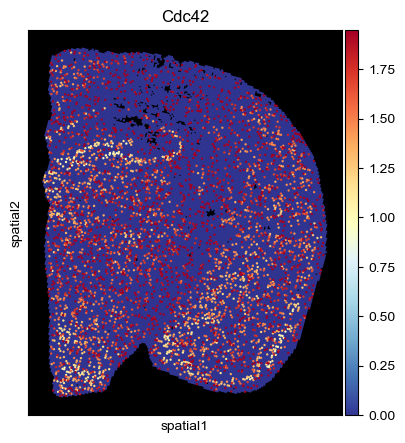

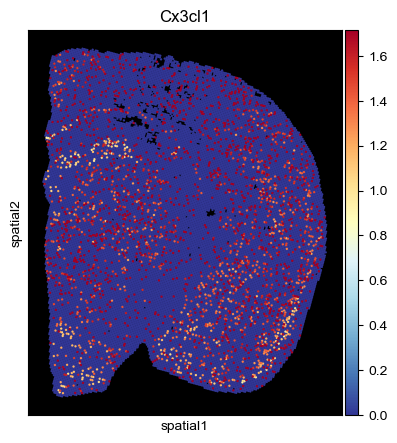

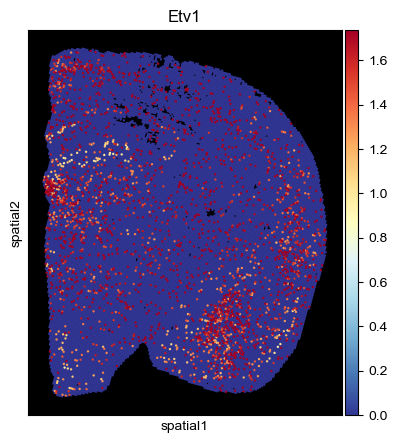

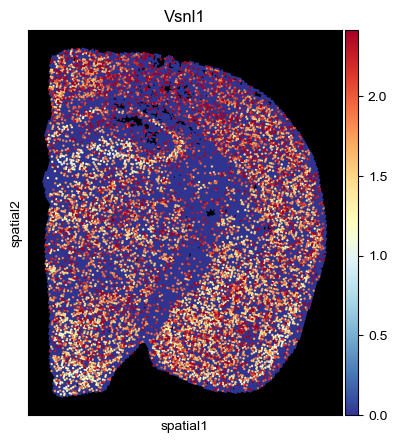

In [84]:
for gene in ['Cdc42','Cx3cl1','Etv1','Vsnl1']:
    
    fig,ax=plt.subplots(figsize=(5,5))
    ax.set_facecolor('black')
    sc.pl.spatial(adata_c3, color=[gene], spot_size=70, cmap='RdYlBu_r',vmax='p95',ax=ax)

    plt.rcParams['pdf.fonttype'] = 42
    plt.rcParams['font.sans-serif'] = 'Arial'
    ax.set_facecolor('black')

    # fig.savefig('./组图/inferno/Vsnl1_4.pdf')
    plt.show()

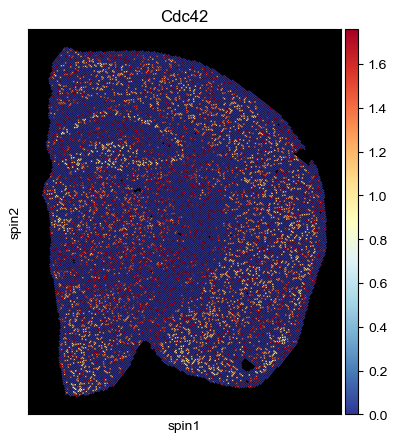

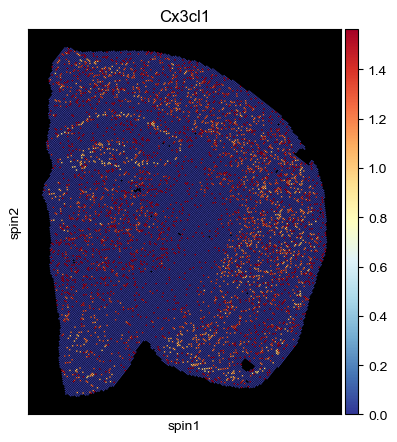

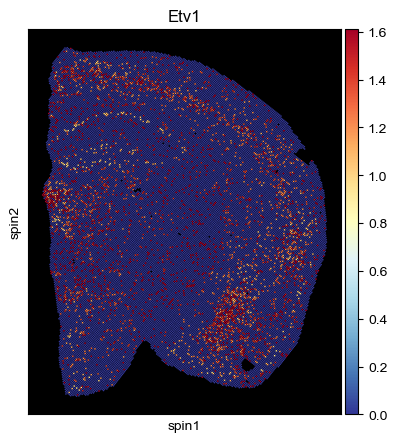

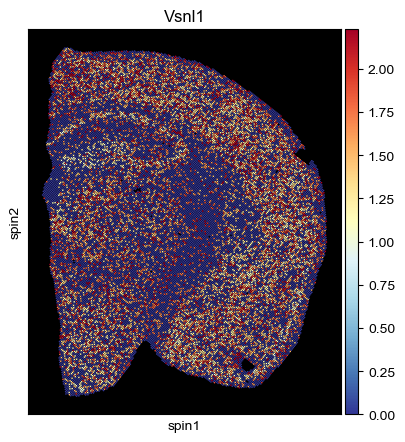

In [83]:
for gene in ['Cdc42','Cx3cl1','Etv1','Vsnl1']:
    
    fig,ax=plt.subplots(figsize=(5,5))
    ax.set_facecolor('black')
    sc.pl.spatial(adata_c4, basis='spin', color=[gene], spot_size=50, cmap='RdYlBu_r',vmax='p95',ax=ax)

    plt.rcParams['pdf.fonttype'] = 42
    plt.rcParams['font.sans-serif'] = 'Arial'
    ax.set_facecolor('black')

    # fig.savefig('./组图/inferno/Vsnl1_4.pdf')
    plt.show()

In [68]:
ffpe_1=sc.read_visium('/home/lixinxing/V2/diffusion/FFPE/Rep1/',count_file='/home/lixinxing/V2/diffusion/FFPE/Rep1/CytAssist_FFPE_Mouse_Brain_Rep1_filtered_feature_bc_matrix.h5')
ffpe_1.var['mt'] = ffpe_1.var_names.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(ffpe_1, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)
ffpe_1.var_names_make_unique()

sc.pp.normalize_total(ffpe_1, target_sum=1e4)
sc.pp.log1p(ffpe_1)

spatial_data = ffpe_1.obsm['spatial']
spatial_data_numeric = np.array(spatial_data, dtype=float)
ffpe_1.obsm['spatial'] = spatial_data_numeric

spatial_coords = pd.read_csv('/home/lixinxing/V2/diffusion/FFPE/Rep1/spatial/tissue_positions_list.csv')
spatial_coords_filtered = spatial_coords[spatial_coords['barcode'].isin(ffpe_1.obs_names)]
spatial_coords_filtered.index = spatial_coords['barcode'][spatial_coords['barcode'].isin(ffpe_1.obs_names)]

spatial_coords_aligned = spatial_coords_filtered.loc[ffpe_1.obs_names]

# ffpe_1.obsm['spatial_2'] = spatial_coords_aligned.values
ffpe_1.obsm['spatial_2'] =spatial_coords_aligned[['pxl_row_in_fullres','pxl_col_in_fullres']].values  #有旋转 
ffpe_1.obsm['spatial_3'] =spatial_coords_aligned[['array_row','array_col']].values  #位置信息
spot_diameter_um = 55
spot_spacing_um = 100

array_coords = ffpe_1.obsm['spatial_3']
physical_coords = np.zeros(array_coords.shape)

physical_coords[:, 0] = array_coords[:, 0] * spot_spacing_um  # 对于 array_row
physical_coords[:, 1] = array_coords[:, 1] * (spot_spacing_um / 2)  # 对于 array_col
ffpe_1.obsm['physical_coords'] = physical_coords
ffpe_1

/home/lixinxing/anaconda3/envs/immune/lib/python3.8/site-packages/anndata/_core/anndata.py:1832: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


AnnData object with n_obs × n_vars = 2310 × 19465
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'spatial', 'log1p'
    obsm: 'spatial', 'spatial_2', 'spatial_3', 'physical_coords'

In [72]:
ffpe_2=sc.read_visium('/home/lixinxing/V2/diffusion/FFPE/Rep2/',count_file='/home/lixinxing/V2/diffusion/FFPE/Rep2/CytAssist_FFPE_Mouse_Brain_Rep2_filtered_feature_bc_matrix.h5')
ffpe_2.var['mt'] = ffpe_2.var_names.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(ffpe_2, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)
ffpe_2.var_names_make_unique()

sc.pp.normalize_total(ffpe_2, target_sum=2e4)
sc.pp.log1p(ffpe_2)

spatial_data = ffpe_2.obsm['spatial']
spatial_data_numeric = np.array(spatial_data, dtype=float)
ffpe_2.obsm['spatial'] = spatial_data_numeric

spatial_coords = pd.read_csv('/home/lixinxing/V2/diffusion/FFPE/Rep2/spatial/tissue_positions_list.csv')
spatial_coords_filtered = spatial_coords[spatial_coords['barcode'].isin(ffpe_2.obs_names)]
spatial_coords_filtered.index = spatial_coords['barcode'][spatial_coords['barcode'].isin(ffpe_2.obs_names)]

spatial_coords_aligned = spatial_coords_filtered.loc[ffpe_2.obs_names]

# ffpe_1.obsm['spatial_2'] = spatial_coords_aligned.values
ffpe_2.obsm['spatial_2'] =spatial_coords_aligned[['pxl_row_in_fullres','pxl_col_in_fullres']].values  #有旋转 
ffpe_2.obsm['spatial_3'] =spatial_coords_aligned[['array_row','array_col']].values  #位置信息

spot_diameter_um = 55
spot_spacing_um = 100

array_coords = ffpe_2.obsm['spatial_3']
physical_coords = np.zeros(array_coords.shape)

physical_coords[:, 0] = array_coords[:, 0] * spot_spacing_um  # 对于 array_row
physical_coords[:, 1] = array_coords[:, 1] * (spot_spacing_um / 2)  # 对于 array_col
ffpe_2.obsm['physical_coords'] = physical_coords
ffpe_2

/home/lixinxing/anaconda3/envs/immune/lib/python3.8/site-packages/anndata/_core/anndata.py:1832: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


AnnData object with n_obs × n_vars = 2235 × 19465
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'spatial', 'log1p'
    obsm: 'spatial', 'spatial_2', 'spatial_3', 'physical_coords'

In [13]:
ffpe_1=sc.read_h5ad('/home/lixinxing/V2/diffusion/FFPE/ffpe1.h5ad')
ffpe_2=sc.read_h5ad('/home/lixinxing/V2/diffusion/FFPE/ffpe2.h5ad')
ffpe_1.obs['sample']='ffpe_1'
ffpe_2.obs['sample']='ffpe_2'

In [83]:
adata_list=[adata_c3,adata_c4,ffpe_1,ffpe_2]
adata_combin=sc.concat(adata_list,join='outer')
adata_combin

/home/lixinxing/anaconda3/envs/immune/lib/python3.8/site-packages/anndata/_core/anndata.py:1830: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


AnnData object with n_obs × n_vars = 63477 × 36011
    obs: 'orig.ident', 'x', 'y', 'sample', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_rp', 'pct_counts_rp', 'leiden', 'res_0.8', 'res_1', 'res_1.2', 'res_1.5', 'res_2', 'in_tissue', 'array_row', 'array_col'
    obsm: 'X_pca', 'X_umap', 'spatial', 'spin', 'spatial_2', 'spatial_3', 'physical_coords'

/home/lixinxing/anaconda3/envs/immune/lib/python3.8/site-packages/anndata/_core/anndata.py:1222: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/home/lixinxing/anaconda3/envs/immune/lib/python3.8/site-packages/anndata/_core/anndata.py:1222: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/home/lixinxing/anaconda3/envs/immune/lib/python3.8/site-packages/anndata/_core/anndata.py:1222: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/home/lixinxing/anaconda3/envs/immune/lib/python3.8/site-packages/anndata/_core/anndata.py:1222: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


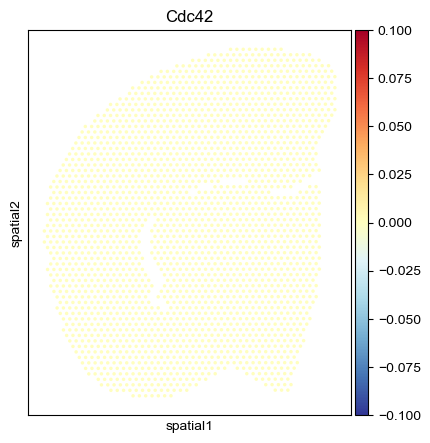

/home/lixinxing/anaconda3/envs/immune/lib/python3.8/site-packages/anndata/_core/anndata.py:1222: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/home/lixinxing/anaconda3/envs/immune/lib/python3.8/site-packages/anndata/_core/anndata.py:1222: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/home/lixinxing/anaconda3/envs/immune/lib/python3.8/site-packages/anndata/_core/anndata.py:1222: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/home/lixinxing/anaconda3/envs/immune/lib/python3.8/site-packages/anndata/_core/anndata.py:1222: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


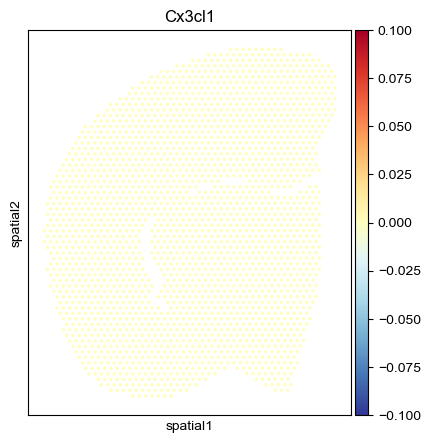

/home/lixinxing/anaconda3/envs/immune/lib/python3.8/site-packages/anndata/_core/anndata.py:1222: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/home/lixinxing/anaconda3/envs/immune/lib/python3.8/site-packages/anndata/_core/anndata.py:1222: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/home/lixinxing/anaconda3/envs/immune/lib/python3.8/site-packages/anndata/_core/anndata.py:1222: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/home/lixinxing/anaconda3/envs/immune/lib/python3.8/site-packages/anndata/_core/anndata.py:1222: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


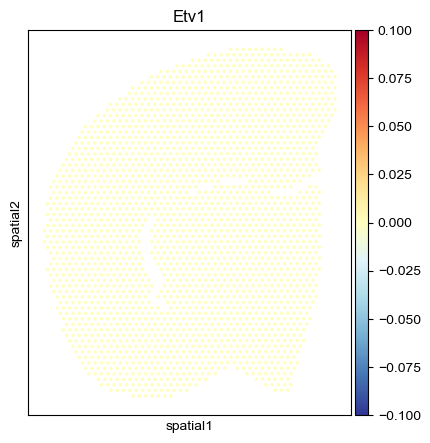

/home/lixinxing/anaconda3/envs/immune/lib/python3.8/site-packages/anndata/_core/anndata.py:1222: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/home/lixinxing/anaconda3/envs/immune/lib/python3.8/site-packages/anndata/_core/anndata.py:1222: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/home/lixinxing/anaconda3/envs/immune/lib/python3.8/site-packages/anndata/_core/anndata.py:1222: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/home/lixinxing/anaconda3/envs/immune/lib/python3.8/site-packages/anndata/_core/anndata.py:1222: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


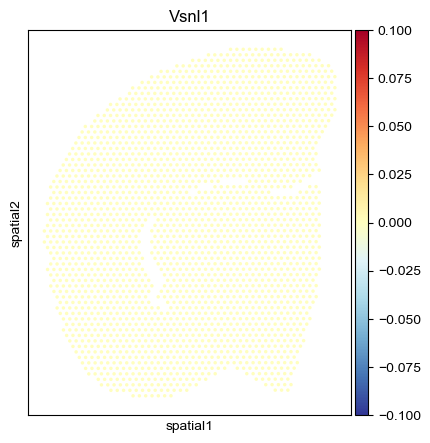

In [92]:
for gene in ['Cdc42','Cx3cl1','Etv1','Vsnl1']:
    
    fig,ax=plt.subplots(figsize=(5,5))
    ax.set_facecolor('white')
    sc.pl.spatial(adata_combin[adata_combin.obs['sample'].isin(['ffpe_1'])], color=[gene], spot_size=200, vmin=0,cmap='RdYlBu_r',ax=ax)

    plt.rcParams['pdf.fonttype'] = 42
    plt.rcParams['font.sans-serif'] = 'Arial'
    ax.set_facecolor('black')

    # fig.savefig('./组图/inferno/Vsnl1_4.pdf')
    plt.show()

# Fig2 D

## Stereo-seq V2 cell segmentation annotation

### 1、Data processing

In [157]:
data1 = sc.read_h5ad('/home/lee/project/v2/mouse_brain/cell_segmentation/C3.cell_gene.h5ad')
data2 = sc.read_h5ad('/home/lee/project/v2/mouse_brain/cell_segmentation/C4.cell_gene.h5ad')

data1.obs_names = 'C3_' + data1.obs_names
data2.obs_names = 'C4_' + data2.obs_names

del data1.obsm['contour']
del data2.obsm['contour']

adata = sc.concat([data1,data2],join = 'outer')
sc.pp.calculate_qc_metrics(adata,inplace = True)

In [161]:
adata = adata[(adata.obs.area < 1600) & (adata.obs.area > 400)].copy()
adata.layers['counts']=adata.X.copy()
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)
sc.tl.pca(adata)
sc.pp.neighbors(adata)
sc.tl.leiden(adata, resolution = 4)
adata.obs['chip'] = [i.split('_')[0] for i in adata.obs_names]

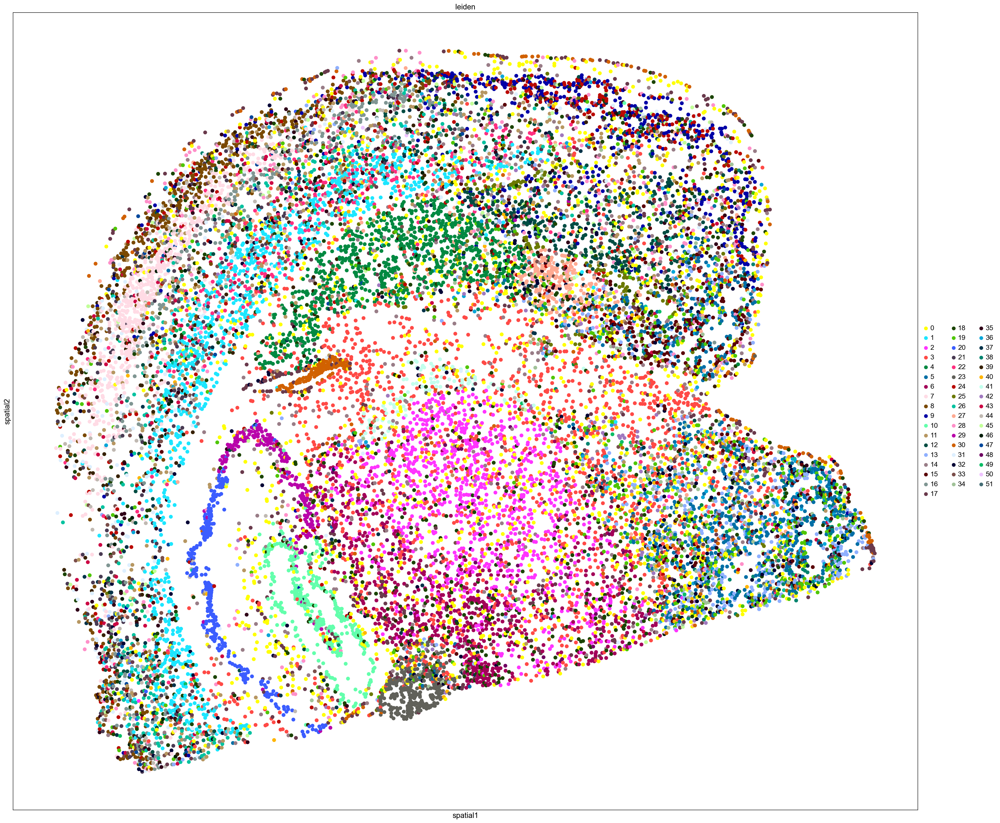

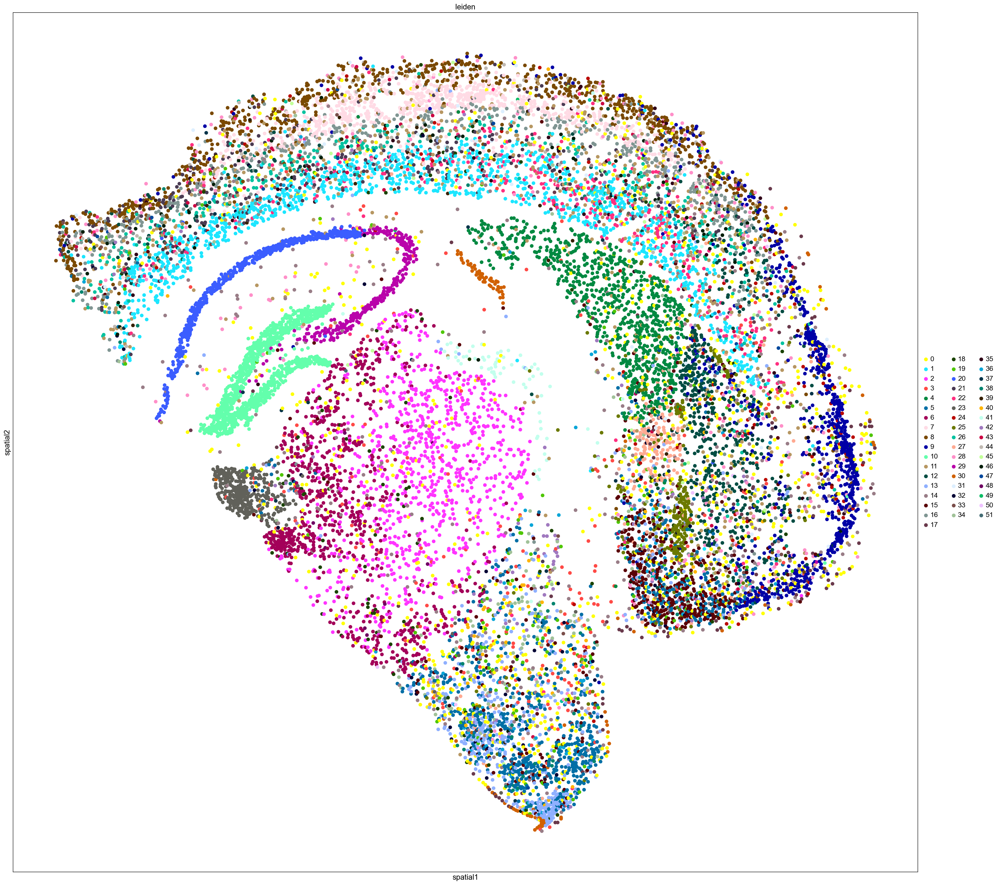

In [175]:
for id in adata.obs['chip'].unique():
    sc.pl.spatial(adata[adata.obs.chip == id].copy(),color = 'leiden',spot_size = 50,size = 1,save  = f'_{id}_leiden_4.pdf',palette=sc.pl.palettes.default_102)

### 2、Cluster annotation

#### 经典marker genes

/home/lixinxing/anaconda3/envs/immune/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


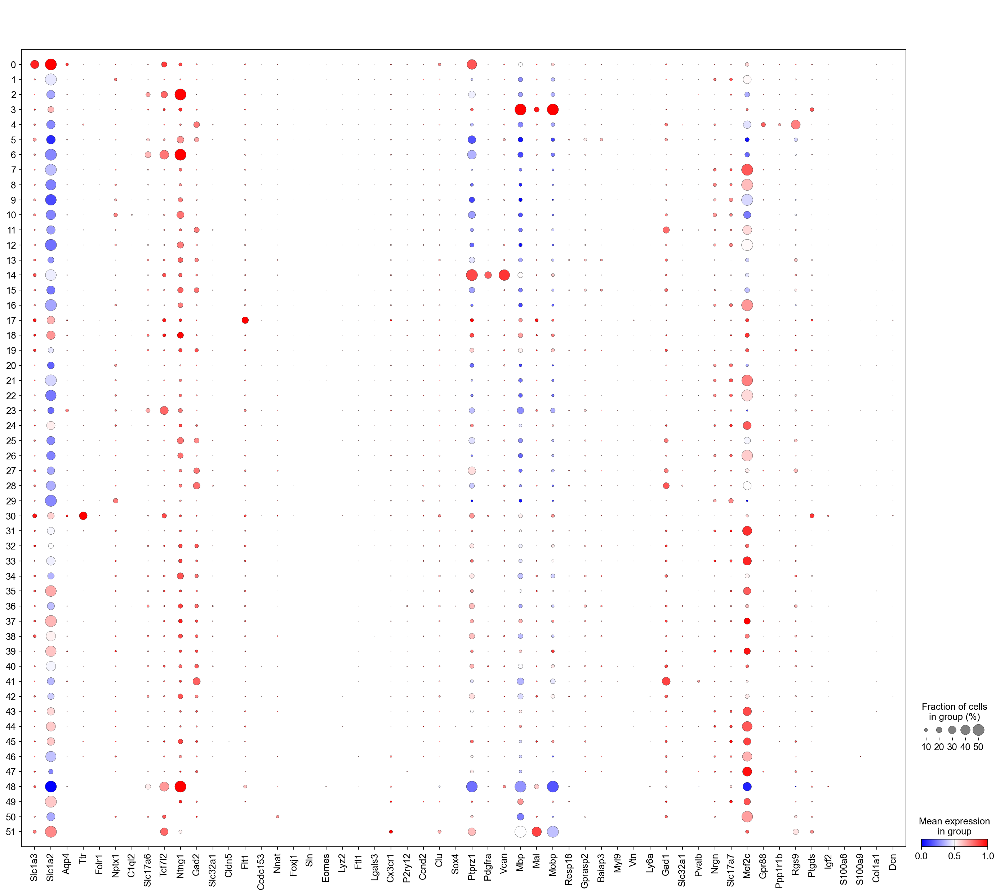

In [176]:
genes  = ["Slc1a3","Slc1a2","Aqp4","Ttr","Folr1","Nptx1","C1ql2","Slc17a6","Tcf7l2","Ntng1","Gad2","Slc32a1","Cldn5",
          "Flt1","Ccdc153","Nnat","Foxj1","Sln","Eomes","Lyz2","Ftl1","Lgals3","Cx3cr1","P2ry12","Ccnd2","Clu","Sox4","Ptprz1","Pdgfra","Vcan","Mbp","Mal","Mobp","Resp18",
          "Gprasp2","Baiap3","Myl9","Vtn","Ly6a","Gad1","Slc32a1","Pvalb","Nrgn","Slc17a7","Mef2c","Gpr88","Ppp1r1b","Rgs9","Ptgds","Igf2","S100a8","S100a9","Col1a1","Dcn",]
sc.set_figure_params(figsize=(30,30))

sc.pl.dotplot(adata, genes, 'leiden',cmap = 'bwr',dot_max=0.5, standard_scale='var', mean_only_expressed = True )

#### top_rank genes

In [186]:
sc.tl.rank_genes_groups(adata, groupby='leiden')
dedf = sc.get.rank_genes_groups_df(adata, key='rank_genes_groups',group =None)
dedf = dedf.sort_values(by=['group',"scores"], ascending=False).groupby('group').head(50)
dedf.to_csv(f'de_leiden.csv')
dedf

,group,names,scores,logfoldchanges,pvals,pvals_adj
2528172,51,Zbtb20,13.864017,3.691084,2.124109e-07,5.769661e-07
2528173,51,Trpm3,10.822702,4.571173,1.817420e-06,4.705095e-06
2528174,51,Plcl1,10.118424,3.937415,3.190793e-06,8.147838e-06
2528175,51,Malat1,9.225699,1.449468,6.840176e-06,1.705640e-05
2528176,51,Pex5l,5.177973,3.664139,5.797539e-04,1.247810e-03
...,...,...,...,...,...,...
45,0,Trps1,20.893637,1.779156,9.376746e-90,2.472468e-87
46,0,Gpc6,20.888111,1.574735,8.312768e-90,2.203639e-87
47,0,Nwd1,20.774235,3.414088,1.630110e-88,4.208741e-86
48,0,Plce1,20.622095,2.796409,2.053567e-87,5.193847e-85


#### region-celltype-markers

In [262]:
marker_genes_dict = {}
marker_genes_dict['Astrocytes'] = [ 'Slc1a3','Slc1a2']
marker_genes_dict['Choroid plexus epithelial cells'] = [ 'Ttr','Clic6']
marker_genes_dict['Di- and mesencephalon excitatory neurons'] = [ 'Slc17a6','Ntng1']
marker_genes_dict['Endothelial cells'] = [ 'Cldn5','Flt1']
marker_genes_dict['Glutamatergic neuroblasts'] = [ 'Lrrc55']
marker_genes_dict['Oligodendrocyte precursor cells'] = [ 'Ptprz1','Pdgfra','Vcan']
marker_genes_dict['Oligodendrocytes'] = [ 'Mbp','Mal','Mobp']
marker_genes_dict['Peptidergic neurons'] = [ 'Gad2','Arhgap6']
marker_genes_dict['Telencephalon inhibitory interneurons'] = [ 'Adarb2','Grik1']
marker_genes_dict['Telencephalon projecting excitatory neurons'] = [ 'Nrgn','Slc17a7','Mef2c']
marker_genes_dict['Telencephalon projecting inhibitory neurons'] = [ 'Gpr88','Ppp1r1b','Rgs9']

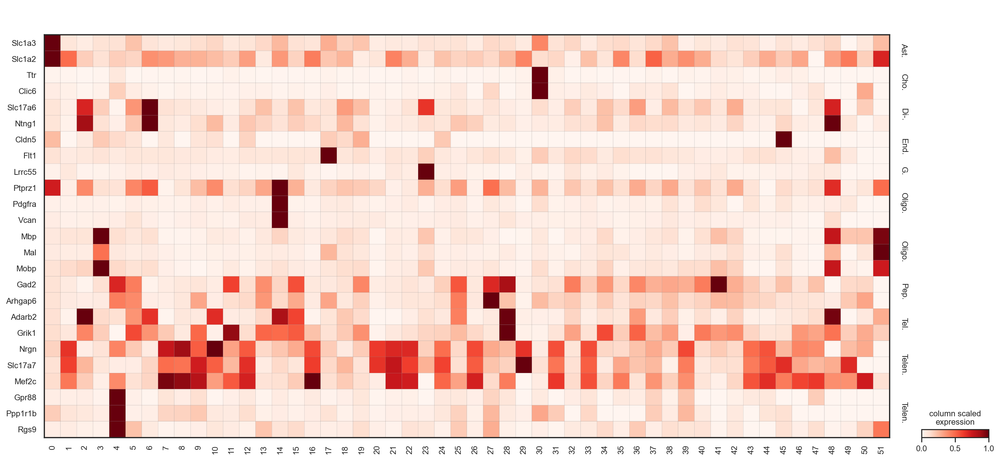

In [263]:
sc.pl.matrixplot(adata, marker_genes_dict, groupby='leiden',dendrogram=False,swap_axes=True,
                 cmap='Reds', save = "_marker_heatmap.pdf",
                 standard_scale='var', colorbar_title='column scaled\nexpression')

In [ ]:
clusterannotation={'0': 'Astrocytes',
 '1': 'Telencephalon projecting excitatory neurons',
 '2': 'Di- and mesencephalon excitatory neurons',
 '3': 'Oligodendrocytes',
 '4': 'Telencephalon projecting inhibitory neurons',
 '5': 'Peptidergic neurons',
 '6': 'Di- and mesencephalon excitatory neurons',
 '7': 'Telencephalon projecting excitatory neurons',
 '8': 'Telencephalon projecting excitatory neurons',
 '9': 'Telencephalon projecting excitatory neurons',
 '10': 'Telencephalon projecting excitatory neurons',
 '11': 'Telencephalon inhibitory interneurons',
 '12': 'Di- and mesencephalon excitatory neurons',
 '13': 'Peptidergic neurons',
 '14': 'Oligodendrocyte precursor cells',
 '15': 'Peptidergic neurons',
 '16': 'Telencephalon projecting excitatory neurons',
 '17': 'Endothelial cells',
 '18': 'Di- and mesencephalon excitatory neurons',
 '19': 'Peptidergic neurons',
 '20': 'Telencephalon projecting excitatory neurons',
 '21': 'Telencephalon projecting excitatory neurons',
 '22': 'Telencephalon projecting excitatory neurons',
 '23': 'Glutamatergic neuroblasts',
 '24': 'Telencephalon projecting excitatory neurons',
 '25': 'Telencephalon inhibitory interneurons',
 '26': 'Telencephalon projecting excitatory neurons',
 '27': 'Peptidergic neurons',
 '28': 'Telencephalon inhibitory interneurons',
 '29': 'Telencephalon projecting excitatory neurons',
 '30': 'Choroid plexus epithelial cells',
 '31': 'Telencephalon projecting excitatory neurons',
 '32': 'Telencephalon inhibitory interneurons',
 '33': 'Telencephalon projecting excitatory neurons',
 '34': 'Peptidergic neurons',
 '35': 'Telencephalon projecting excitatory neurons',
 '36': 'Peptidergic neurons',
 '37': 'Telencephalon projecting excitatory neurons',
 '38': 'Telencephalon projecting excitatory neurons',
 '39': 'Telencephalon projecting excitatory neurons',
 '40': 'Peptidergic neurons',
 '41': 'Peptidergic neurons',
 '42': 'Peptidergic neurons',
 '43': 'Telencephalon projecting excitatory neurons',
 '44': 'Telencephalon projecting excitatory neurons',
 '45': 'Telencephalon projecting excitatory neurons',
 '46': 'Telencephalon projecting excitatory neurons',
 '47': 'Telencephalon projecting excitatory neurons',
 '48': 'Di- and mesencephalon excitatory neurons',
 '49': 'Telencephalon projecting excitatory neurons',
 '50': 'Telencephalon projecting excitatory neurons',
 '51': 'Astrocytes'}

adata.obs['primary_annotation'] = adata.obs['leiden'].map(clusterannotation).astype('category')

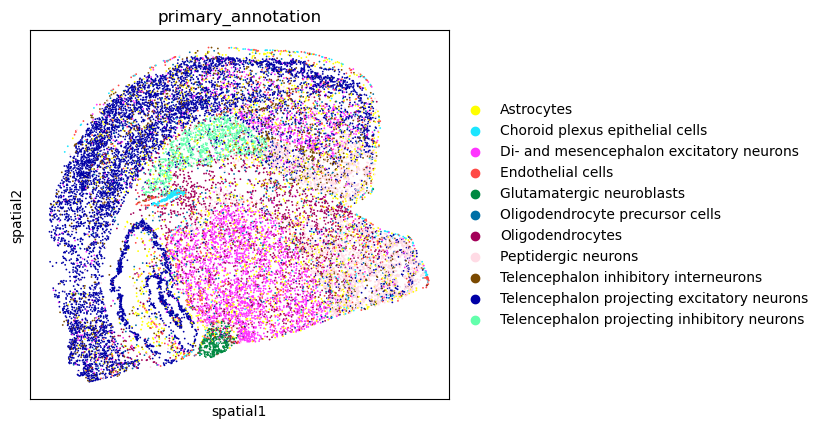

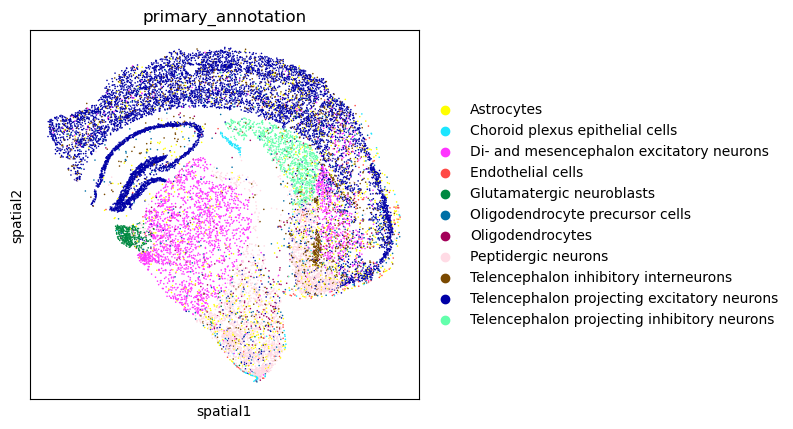

In [271]:
for id in adata.obs['chip'].unique():
    sc.pl.spatial(adata[adata.obs.chip == id].copy(),color = 'primary_annotation',spot_size = 50,size = 1,palette=sc.pl.palettes.default_102)

### 3、Subcluster refinement

In [ ]:
data1 = sc.read_h5ad('/home/lee/project/v2/mouse_brain/cell_segmentation/C3.cell_gene.h5ad')
data2 = sc.read_h5ad('/home/lee/project/v2/mouse_brain/cell_segmentation/C4.cell_gene.h5ad')
data1.obs_names = 'C3_' + data1.obs_names
data2.obs_names = 'C4_' + data2.obs_names
adata = sc.concat([data1,data2],join = 'outer')

#### Subcluster refinement--Di- and mesencephalon excitatory neurons

In [ ]:
adata_sub=adata[adata.obs['primary_annotation'].isin(['Di- and mesencephalon excitatory neurons'])].copy()
adata_sub.X.data

array([2., 3., 1., ..., 1., 1., 1.], dtype=float32)

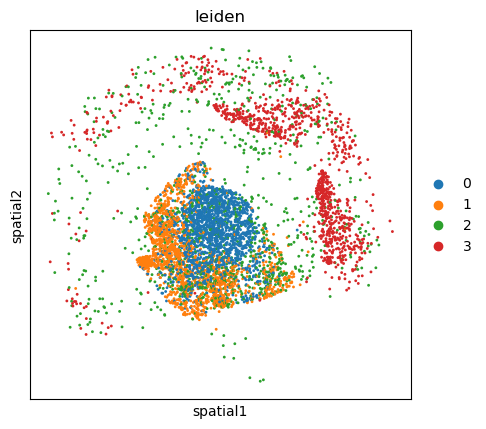

In [192]:
sc.pp.normalize_total(adata_sub, target_sum=1e4)
sc.pp.log1p(adata_sub)
sc.pp.highly_variable_genes(adata_sub, min_mean=0.0125, max_mean=3, min_disp=0.5)
sc.tl.pca(adata_sub)
sc.pp.neighbors(adata_sub)
sc.tl.umap(adata_sub)
sc.tl.leiden(adata_sub, resolution = 0.8)

sc.pl.spatial(adata_sub,color='leiden',spot_size=90)

In [289]:
clusterannotation={'0': 'Di- and mesencephalon excitatory neurons_1',
 '1': 'Di- and mesencephalon excitatory neurons_2',
 '2': 'Di- and mesencephalon excitatory neurons_3',
 '3': 'Di- and mesencephalon excitatory neurons_4'}

adata_sub.obs['annotation'] = adata_sub.obs['leiden'].map(clusterannotation).astype('category')

#### Subcluster refinement--Telencephalon inhibitory interneurons

In [211]:
adata_sub3=adata[adata.obs['primary_annotation'].isin(['Telencephalon inhibitory interneurons'])].copy()
adata_sub3.X.data

array([6., 2., 2., ..., 1., 1., 1.], dtype=float32)

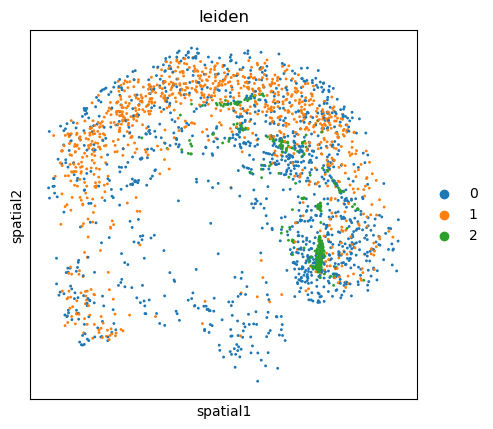

In [218]:
sc.pp.normalize_total(adata_sub3, target_sum=1e4)
sc.pp.log1p(adata_sub3)
sc.pp.highly_variable_genes(adata_sub3, min_mean=0.0125, max_mean=3, min_disp=0.5)
sc.tl.pca(adata_sub3)
sc.pp.neighbors(adata_sub3)
sc.tl.umap(adata_sub3)
sc.tl.leiden(adata_sub3, resolution = 0.3)
sc.pl.spatial(adata_sub3,color='leiden',spot_size=90)

/home/lixinxing/anaconda3/envs/immune/lib/python3.8/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list


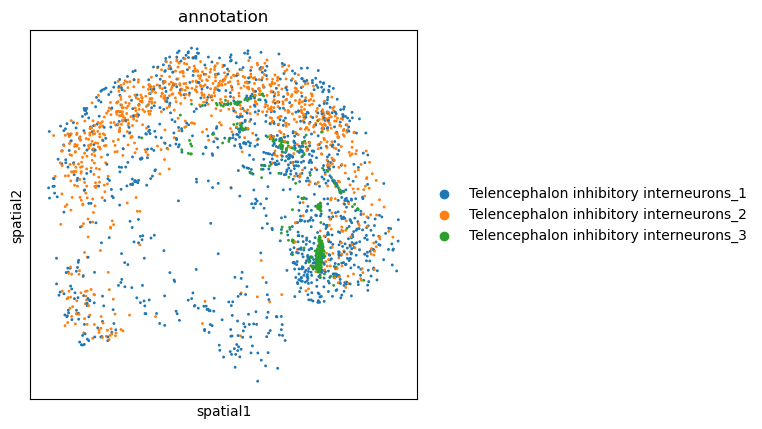

In [217]:
sc.pl.spatial(adata2[adata2.obs['primary_annotation'].isin(['Telencephalon inhibitory interneurons'])],color='annotation',spot_size=90)

In [288]:
clusterannotation={'0': 'Telencephalon inhibitory interneurons_1',
 '1': 'Telencephalon inhibitory interneurons_2',
 '2': 'Telencephalon inhibitory interneurons_3'}

adata_sub3.obs['annotation'] = adata_sub3.obs['leiden'].map(clusterannotation).astype('category')

#### Subcluster refinement--Telencephalon projecting excitatory neurons

In [200]:
adata_sub2=adata[adata.obs['primary_annotation'].isin(['Telencephalon projecting excitatory neurons'])].copy()
adata_sub2.X.data

array([2., 3., 1., ..., 1., 1., 1.], dtype=float32)

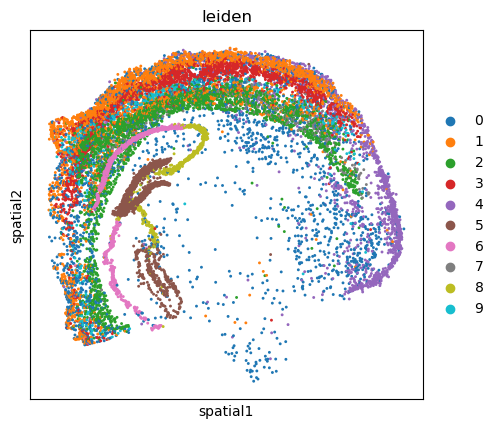

In [202]:
sc.pp.normalize_total(adata_sub2, target_sum=1e4)
sc.pp.log1p(adata_sub2)
sc.pp.highly_variable_genes(adata_sub2, min_mean=0.0125, max_mean=3, min_disp=0.5)
sc.tl.pca(adata_sub2)
sc.pp.neighbors(adata_sub2)
sc.tl.umap(adata_sub2)
sc.tl.leiden(adata_sub2, resolution = 0.8)

sc.pl.spatial(adata_sub2,color='leiden',spot_size=90)

/home/lixinxing/anaconda3/envs/immune/lib/python3.8/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list


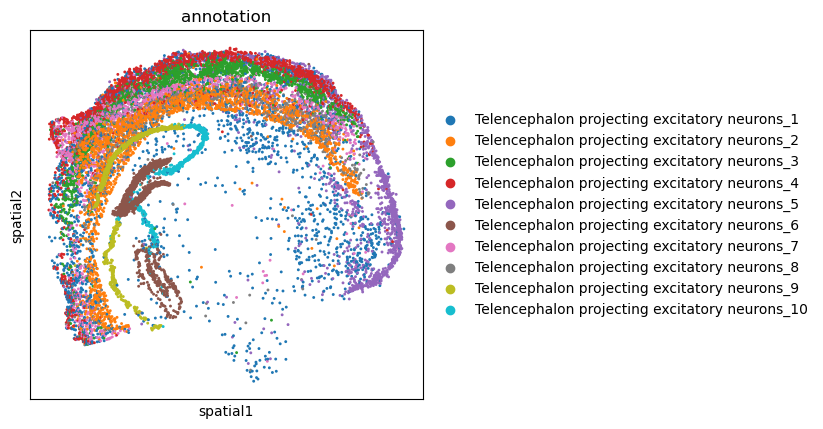

In [205]:
sc.pl.spatial(adata2[adata2.obs['primary_annotation'].isin(['Telencephalon projecting excitatory neurons'])],color='annotation',spot_size=90)

In [286]:
clusterannotation={'0': 'Telencephalon projecting excitatory neurons_1',
 '1': 'Telencephalon projecting excitatory neurons_2',
 '2': 'Telencephalon projecting excitatory neurons_3',
 '3': 'Telencephalon projecting excitatory neurons_4',
 '4': 'Telencephalon projecting excitatory neurons_5',
 '5': 'Telencephalon projecting excitatory neurons_6',
 '6': 'Telencephalon projecting excitatory neurons_7',
 '7': 'Telencephalon projecting excitatory neurons_8',
 '8': 'Telencephalon projecting excitatory neurons_9',
 '9': 'Telencephalon projecting excitatory neurons_10'}

adata_sub2.obs['annotation'] = adata_sub2.obs['leiden'].map(clusterannotation).astype('category')

#### Subcluster refinement--Peptidergic neurons

In [224]:
adata_sub4=adata[adata.obs['primary_annotation'].isin(['Peptidergic neurons'])].copy()
adata_sub4.X.data

array([2., 1., 1., ..., 1., 1., 1.], dtype=float32)

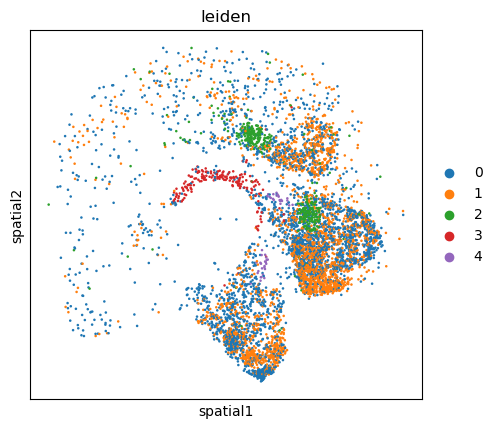

In [227]:
sc.pp.normalize_total(adata_sub4, target_sum=1e4)
sc.pp.log1p(adata_sub4)
sc.pp.highly_variable_genes(adata_sub4, min_mean=0.0125, max_mean=3, min_disp=0.5)
sc.tl.pca(adata_sub4)
sc.pp.neighbors(adata_sub4)
sc.tl.umap(adata_sub4)
sc.tl.leiden(adata_sub4, resolution = 0.5)

sc.pl.spatial(adata_sub4,color='leiden',spot_size=80)

/home/lixinxing/anaconda3/envs/immune/lib/python3.8/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list


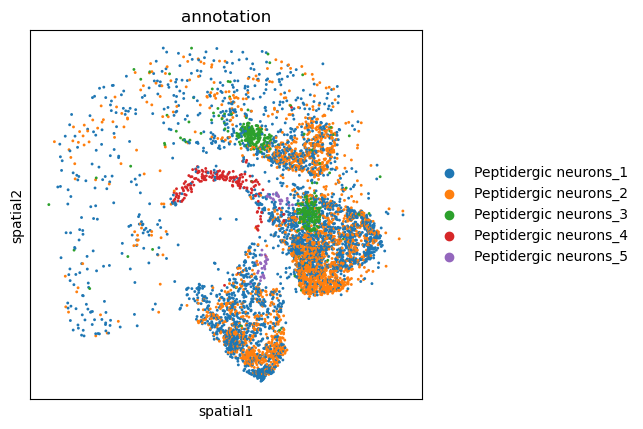

In [ ]:
sc.pl.spatial(adata2[adata2.obs['primary_annotation'].isin(['Peptidergic neurons'])],color='annotation',spot_size=90)

In [285]:
clusterannotation={'0': 'Peptidergic neurons_1',
 '1': 'Peptidergic neurons_2',
 '2': 'Peptidergic neurons_3',
 '3': 'Peptidergic neurons_4',
 '4': 'Peptidergic neurons_5'}

adata_sub4.obs['annotation'] = adata_sub4.obs['leiden'].map(clusterannotation).astype('category')

#### Subcluster refinement--Choroid plexus epithelial cells

In [234]:
adata_sub5=adata[adata.obs['primary_annotation'].isin(['Choroid plexus epithelial cells'])].copy()
adata_sub5.X.data

array([3., 1., 1., ..., 1., 1., 1.], dtype=float32)

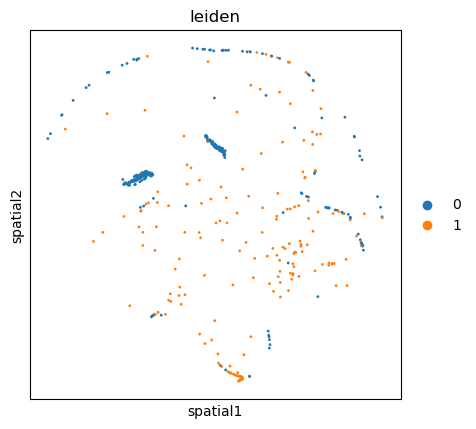

In [236]:
sc.pp.normalize_total(adata_sub5, target_sum=1e4)
sc.pp.log1p(adata_sub5)
sc.pp.highly_variable_genes(adata_sub5, min_mean=0.0125, max_mean=3, min_disp=0.5)
sc.tl.pca(adata_sub5)
sc.pp.neighbors(adata_sub5)
sc.tl.umap(adata_sub5)
sc.tl.leiden(adata_sub5, resolution = 0.3)

sc.pl.spatial(adata_sub5,color='leiden',spot_size=90)

/home/lixinxing/anaconda3/envs/immune/lib/python3.8/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list


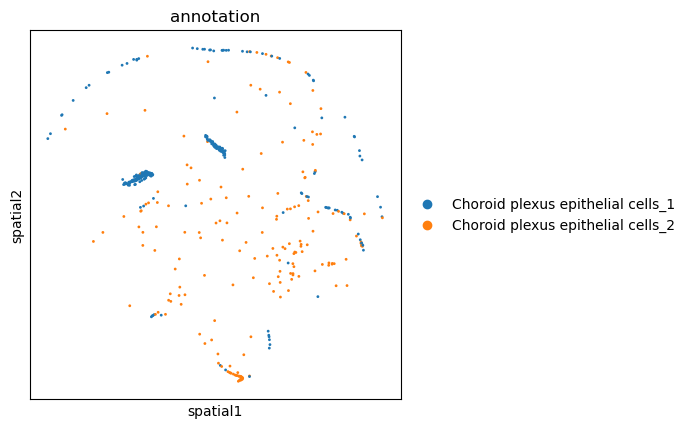

In [ ]:
sc.pl.spatial(adata2[adata2.obs['primary_annotation'].isin(['Choroid plexus epithelial cells'])],color='annotation',spot_size=90)

In [284]:
clusterannotation={'0': 'Choroid plexus epithelial cells_1',
 '1': 'Choroid plexus epithelial cells_2'}

adata_sub5.obs['annotation'] = adata_sub5.obs['leiden'].map(clusterannotation).astype('category')

#### Subcluster refinement--Endothelial cells

In [237]:
adata_sub6=adata[adata.obs['primary_annotation'].isin(['Endothelial cells'])].copy()
adata_sub6.X.data

array([4., 1., 1., ..., 1., 1., 1.], dtype=float32)

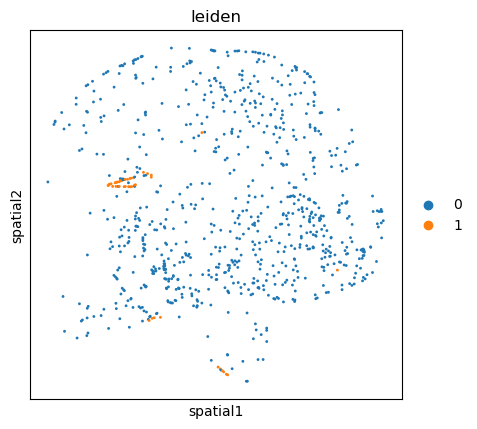

In [241]:
sc.pp.normalize_total(adata_sub6, target_sum=1e4)
sc.pp.log1p(adata_sub6)
sc.pp.highly_variable_genes(adata_sub6, min_mean=0.0125, max_mean=3, min_disp=0.5)
sc.tl.pca(adata_sub6)
sc.pp.neighbors(adata_sub6)
sc.tl.umap(adata_sub6)
sc.tl.leiden(adata_sub6, resolution = 0.2)

sc.pl.spatial(adata_sub6,color='leiden',spot_size=90)

/home/lixinxing/anaconda3/envs/immune/lib/python3.8/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list


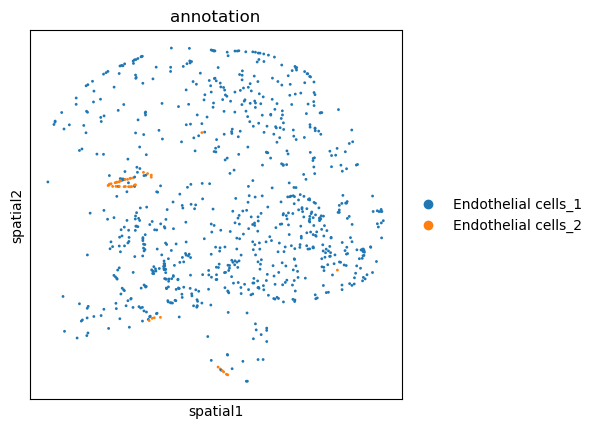

In [ ]:
sc.pl.spatial(adata2[adata2.obs['primary_annotation'].isin(['Endothelial cells'])],color='annotation',spot_size=90)

In [283]:
clusterannotation={'0': 'Endothelial cells_1',
 '1': 'Endothelial cells_2'}

adata_sub6.obs['annotation'] = adata_sub6.obs['leiden'].map(clusterannotation).astype('category')

#### Subcluster refinement--Oligodendrocyte precursor cells

In [242]:
adata_sub7=adata[adata.obs['primary_annotation'].isin(['Oligodendrocyte precursor cells'])].copy()
adata_sub7.X.data

array([3., 2., 1., ..., 1., 1., 1.], dtype=float32)

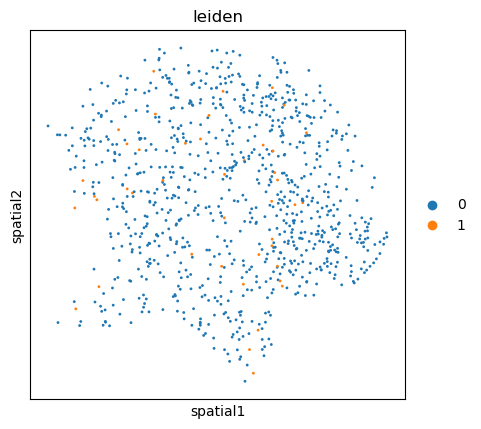

In [245]:
sc.pp.normalize_total(adata_sub7, target_sum=1e4)
sc.pp.log1p(adata_sub7)
sc.pp.highly_variable_genes(adata_sub7, min_mean=0.0125, max_mean=3, min_disp=0.5)
sc.tl.pca(adata_sub7)
sc.pp.neighbors(adata_sub7)
sc.tl.umap(adata_sub7)
sc.tl.leiden(adata_sub7, resolution = 0.2)

sc.pl.spatial(adata_sub7,color='leiden',spot_size=90)

/home/lixinxing/anaconda3/envs/immune/lib/python3.8/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list


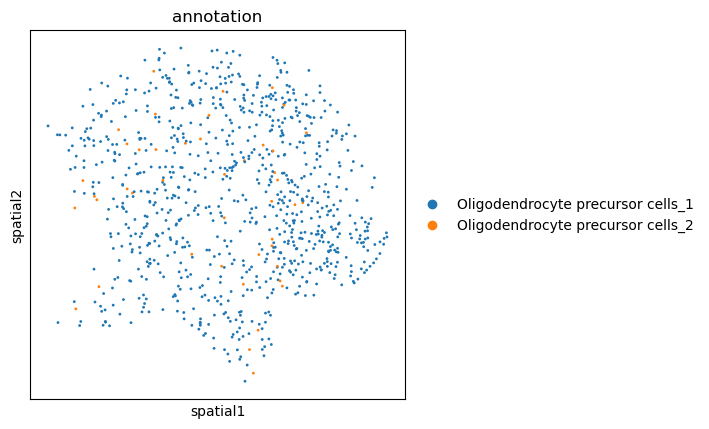

In [ ]:
sc.pl.spatial(adata2[adata2.obs['primary_annotation'].isin(['Oligodendrocyte precursor cells'])],color='annotation',spot_size=90)

In [282]:
clusterannotation={'0': 'Oligodendrocyte precursor cells_1',
 '1': 'Oligodendrocyte precursor cells_2'}

adata_sub7.obs['annotation'] = adata_sub7.obs['leiden'].map(clusterannotation).astype('category')

#### Subcluster refinement--Oligodendrocytes

In [264]:
adata_sub8=adata[adata.obs['primary_annotation'].isin(['Oligodendrocytes'])].copy()
adata_sub8.X.data

array([2., 4., 1., ..., 1., 2., 1.], dtype=float32)

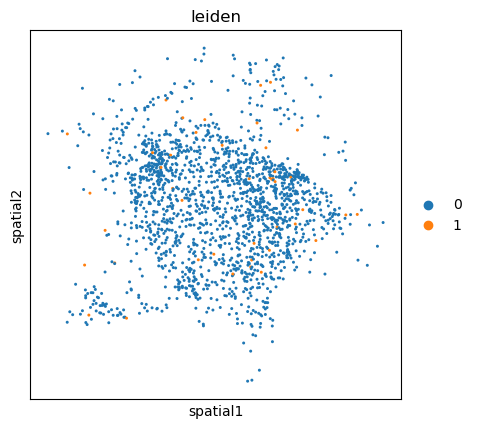

In [266]:
sc.pp.normalize_total(adata_sub8, target_sum=1e4)
sc.pp.log1p(adata_sub8)
sc.pp.highly_variable_genes(adata_sub8, min_mean=0.0125, max_mean=3, min_disp=0.5)
sc.tl.pca(adata_sub8)
sc.pp.neighbors(adata_sub8)
sc.tl.umap(adata_sub8)
sc.tl.leiden(adata_sub8, resolution = 0.3)

sc.pl.spatial(adata_sub8,color='leiden',spot_size=90)

/home/lixinxing/anaconda3/envs/immune/lib/python3.8/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list


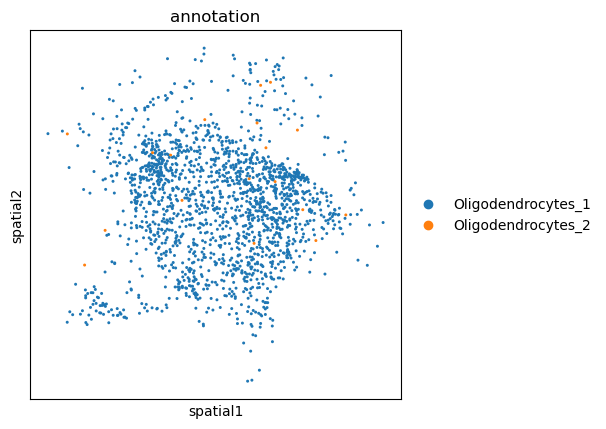

In [ ]:
sc.pl.spatial(adata2[adata2.obs['primary_annotation'].isin(['Oligodendrocytes'])],color='annotation',spot_size=90)

In [281]:
clusterannotation={'0': 'Oligodendrocytes_1',
 '1': 'Oligodendrocytes_2'}

adata_sub8.obs['annotation'] = adata_sub8.obs['leiden'].map(clusterannotation).astype('category')

#### Subcluster refinement--Glutamatergic neuroblasts

In [267]:
adata_sub9=adata[adata.obs['primary_annotation'].isin(['Glutamatergic neuroblasts'])].copy()
adata_sub9.X.data

array([3., 3., 1., ..., 1., 1., 1.], dtype=float32)

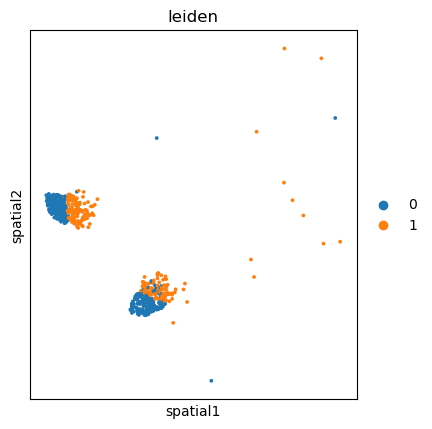

In [270]:
sc.pp.normalize_total(adata_sub9, target_sum=1e4)
sc.pp.log1p(adata_sub9)
sc.pp.highly_variable_genes(adata_sub9, min_mean=0.0125, max_mean=3, min_disp=0.5)
sc.tl.pca(adata_sub9)
sc.pp.neighbors(adata_sub9)
sc.tl.umap(adata_sub9)
sc.tl.leiden(adata_sub9, resolution = 0.3)

sc.pl.spatial(adata_sub9,color='leiden',spot_size=90)

/home/lixinxing/anaconda3/envs/immune/lib/python3.8/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list


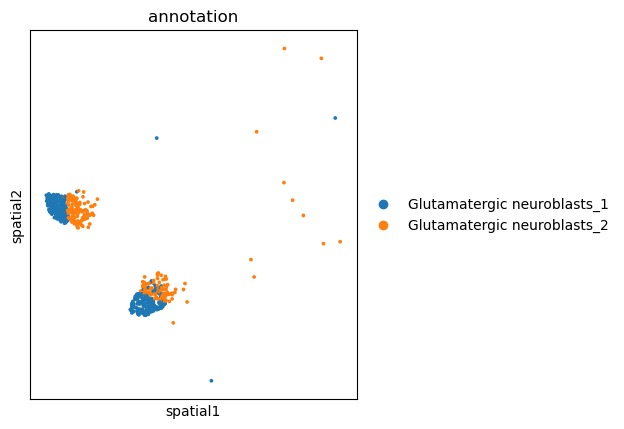

In [ ]:
sc.pl.spatial(adata2[adata2.obs['primary_annotation'].isin(['Glutamatergic neuroblasts'])],color='annotation',spot_size=90)

In [280]:
clusterannotation={'0': 'Glutamatergic neuroblasts_1',
 '1': 'Glutamatergic neuroblasts_2'}

adata_sub9.obs['annotation'] = adata_sub9.obs['leiden'].map(clusterannotation).astype('category')

#### Annotation consolidation

In [292]:
adata.obs['annotation']=adata.obs['primary_annotation'].copy()
adata.obs['annotation']=adata.obs['annotation'].astype(str)

subsets=[adata_sub,adata_sub2,adata_sub3,adata_sub4,adata_sub5,adata_sub6,adata_sub7,adata_sub8,adata_sub9]

for subset in subsets:
    indices=adata.obs_names.isin(subset.obs_names)
    adata.obs.loc[indices,'annotation']=subset.obs['annotation']

/home/lixinxing/anaconda3/envs/immune/lib/python3.8/site-packages/anndata/_core/anndata.py:1222: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


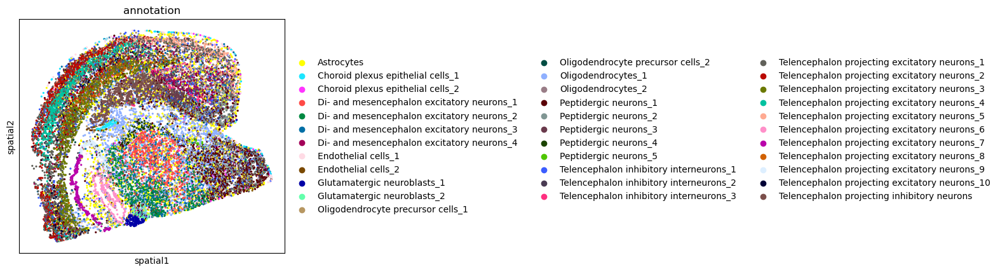

/home/lixinxing/anaconda3/envs/immune/lib/python3.8/site-packages/anndata/_core/anndata.py:1222: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


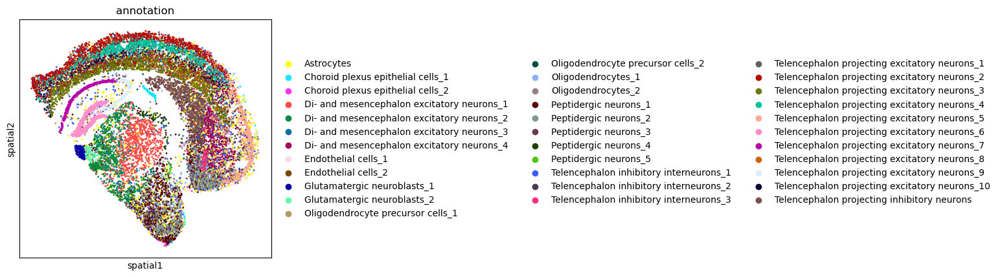

In [298]:
for sample in adata.obs['chip'].unique():
    sc.pl.spatial(adata[adata.obs['chip'].isin([sample])],color='annotation',spot_size=90,palette=sc.pl.palettes.default_102)

### 4、MERFISH data-guided label aggregation

In [9]:
merfish=sc.read_h5ad('/home/lixinxing/V2/diffusion/MERFISH/merfish_v2.h5ad')
sc.pp.normalize_total(merfish,target_sum=1e3)
sc.pp.log1p(merfish)
merfish

AnnData object with n_obs × n_vars = 23148 × 1122
    obs: 'brain_section_label_left', 'brain_section_label_cell_label', 'feature_matrix_label_left', 'donor_label_left', 'donor_genotype_left', 'donor_sex_left', 'cluster_alias_left', 'x_left', 'y_left', 'z_left', 'subclass_confidence_score_left', 'cluster_confidence_score_left', 'high_quality_transfer_left', 'cell_label', 'brain_section_label_right', 'feature_matrix_label_right', 'donor_label_right', 'donor_genotype_right', 'donor_sex_right', 'cluster_alias_right', 'x_right', 'y_right', 'z_right', 'subclass_confidence_score_right', 'cluster_confidence_score_right', 'high_quality_transfer_right', 'cluster_annotation_term_label', 'cluster_annotation_term_set_label', 'cluster_annotation_term_name', 'cluster_annotation_term_set_name', 'number_of_cells', 'color_hex_triplet'
    var: 'gene_symbol'
    uns: 'cluster_annotation_term_name_colors', 'color_hex_triplet_colors'
    obsm: 'spatial', 'spatial_2'

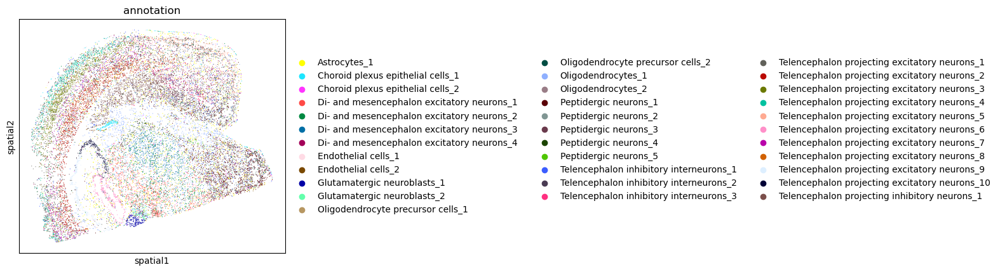

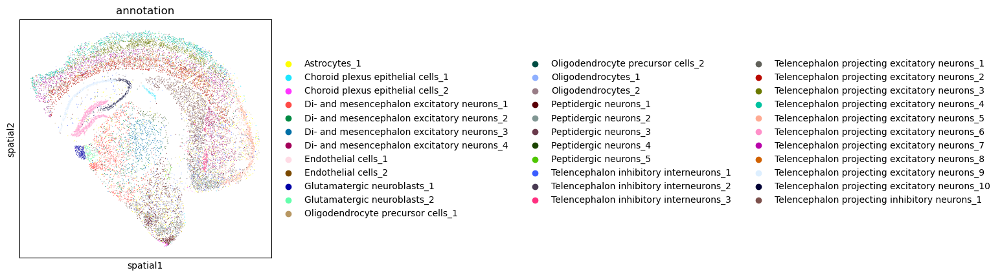

In [4]:
# adata=sc.read_h5ad('/home/lee/project/v2/mouse_brain/cell_segmentation/C3_C4_adata.h5ad')
for sample in adata.obs['chip'].unique():
    sc.pl.spatial(adata[adata.obs['chip'].isin([sample])],color='annotation',spot_size=30)

In [40]:
v2=adata.copy()
v2.raw=v2.copy()
v2

AnnData object with n_obs × n_vars = 36358 × 49572
    obs: 'area', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'leiden', 'chip', 'color', 'annotation', 'primary_annotation', 'sub_leiden'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'color_colors', 'hvg', 'leiden', 'log1p', 'neighbors', 'pca'
    obsm: 'X_pca', 'spatial'
    varm: 'PCs'
    layers: 'spliced', 'unspliced'
    obsp: 'connectivities', 'distances'

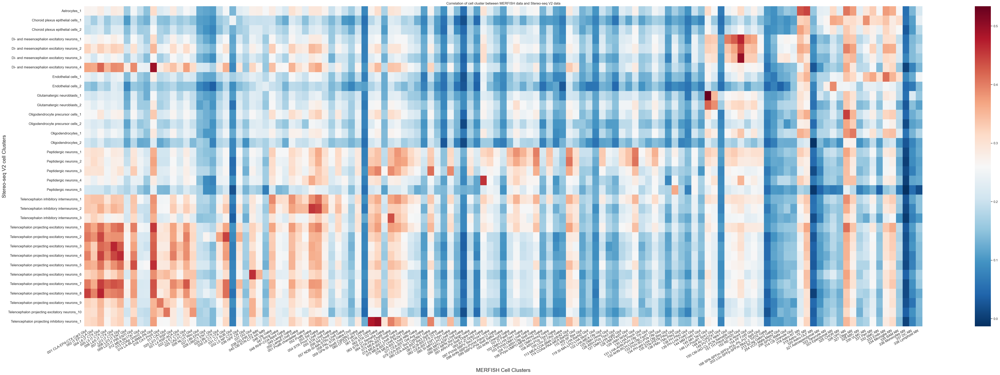

In [41]:
common_genes = merfish.var_names.intersection(v2.var_names)
merfish = merfish[:, common_genes].copy()
v2 = v2[:, common_genes].copy()

merfish_expression = merfish.X.toarray() if issparse(merfish.X) else merfish.X
v2_expression = v2.X.toarray() if issparse(v2.X) else v2.X

merfish_grouped = merfish.obs.groupby('cluster_annotation_term_name')
merfish_sums = {group: merfish_expression[indices].sum(axis=0) for group, indices in merfish_grouped.indices.items()}
merfish_sums_df = pd.DataFrame(merfish_sums, index=common_genes).T

v2_grouped = v2.obs.groupby('annotation')
v2_sums = {group: v2_expression[indices].sum(axis=0) for group, indices in v2_grouped.indices.items()}
v2_sums_df = pd.DataFrame(v2_sums, index=common_genes).T

correlations_spearman = pd.DataFrame(index=v2_sums_df.index, columns=merfish_sums_df.index)

for v2_group in v2_sums_df.index:
    for merfish_group in merfish_sums_df.index:
        correlation, _ = spearmanr(v2_sums_df.loc[v2_group], merfish_sums_df.loc[merfish_group])
        correlations_spearman.loc[v2_group, merfish_group] = correlation

correlations_spearman = correlations_spearman.astype(float)

v2_new_annotations = correlations_spearman.idxmax(axis=1)
v2.obs['annotation_2'] = v2.obs['annotation'].map(v2_new_annotations)

sns.set(style="white")

plt.figure(figsize=(65, 20))
sns.heatmap(correlations_spearman, annot=False, fmt=".2f", cmap='RdBu_r')

plt.title("Correlation of cell cluster between MERFISH data and Stereo-seq V2 data")
plt.xlabel("MERFISH Cell Clusters", fontsize=18)
plt.ylabel("Stereo-seq V2 cell Clusters", fontsize=18)

plt.xticks(rotation=30, fontsize=12,ha='right') 
plt.yticks(fontsize=12) 
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['font.sans-serif'] = 'Arial'
#plt.savefig('../celltype/tcorrelation.pdf')
plt.show()

In [42]:
def get_top_n_annotations(row, n=3):
    """
    获取每行前n个最高的相关性注释。
    """
    return row.nlargest(n).index.tolist()

n_top = 4
top_n_annotations = correlations_spearman.apply(lambda row: get_top_n_annotations(row, n=n_top), axis=1)

final_annotations = {}
for v2_group in top_n_annotations.index:
    for rank, merfish_group in enumerate(top_n_annotations[v2_group]):
        if merfish_group not in final_annotations.values():
            final_annotations[v2_group] = merfish_group
            break
        else:
            continue

v2.obs['new_annotation'] = v2.obs['annotation'].map(final_annotations)
v2.obs['new_annotation'].unique().tolist()

['004 L6 IT CTX Glut',
 '007 L2/3 IT CTX Glut',
 '053 Sst Gaba',
 '079 CEA-BST Six3 Cyp26b1 Gaba',
 '022 L5 ET CTX Glut',
 '326 OPC NN',
 '006 L4/5 IT CTX Glut',
 '014 LA-BLA-BMA-PA Glut',
 '001 CLA-EPd-CTX Car3 Glut',
 '319 Astro-TE NN',
 '009 L2/3 IT PIR-ENTl Glut',
 '052 Pvalb Gaba',
 '129 VMH Nr5a1 Glut',
 '030 L6 CT CTX Glut',
 '330 VLMC NN',
 '333 Endo NN',
 '113 MEA-COA-BMA Ccdc42 Glut',
 nan,
 '062 STR D2 Gaba',
 '016 CA1-ProS Glut',
 '151 TH Prkcd Grin2c Glut',
 '318 Astro-NT NN',
 '049 Lamp5 Gaba',
 '017 CA3 Glut',
 '323 Ependymal NN',
 '037 DG Glut',
 '064 STR-PAL Chst9 Gaba',
 '327 Oligo NN',
 '093 RT-ZI Gnb3 Gaba',
 '145 MH Tac2 Glut',
 '146 LH Pou4f1 Sox1 Glut',
 '135 STN-PSTN Pitx2 Glut']

In [258]:
mapping_df = v2.obs.groupby(['annotation', 'new_annotation']).size().reset_index(name='count')
mapping_df = mapping_df[mapping_df['count'] > 0]

mapping_dict = dict(zip(mapping_df['annotation'], mapping_df['new_annotation']))
mapping_dict

{'Astrocytes_1': '319 Astro-TE NN',
 'Choroid plexus epithelial cells_1': '325 CHOR NN',
 'Choroid plexus epithelial cells_2': '322 Tanycyte NN',
 'Di- and mesencephalon excitatory neurons_1': '151 TH Prkcd Grin2c Glut',
 'Di- and mesencephalon excitatory neurons_2': '150 CM-IAD-CL-PCN Sema5b Glut',
 'Di- and mesencephalon excitatory neurons_3': '327 Oligo NN',
 'Di- and mesencephalon excitatory neurons_4': '014 LA-BLA-BMA-PA Glut',
 'Endothelial cells_1': '333 Endo NN',
 'Endothelial cells_2': '323 Ependymal NN',
 'Glutamatergic neuroblasts_1': '145 MH Tac2 Glut',
 'Glutamatergic neuroblasts_2': '146 LH Pou4f1 Sox1 Glut',
 'Oligodendrocyte precursor cells_1': '326 OPC NN',
 'Oligodendrocyte precursor cells_2': '318 Astro-NT NN',
 'Oligodendrocytes_1': '334 Microglia NN',
 'Oligodendrocytes_2': '053 Sst Gaba',
 'Peptidergic neurons_1': '104 TU-ARH Otp Six6 Gaba',
 'Peptidergic neurons_2': '129 VMH Nr5a1 Glut',
 'Peptidergic neurons_3': '079 CEA-BST Six3 Cyp26b1 Gaba',
 'Peptidergic neu

In [44]:
mapping_dict={
 'Astrocytes_1': 'Astrocytes_1',
 'Choroid plexus epithelial cells_1': 'CHOR NN',
 'Choroid plexus epithelial cells_2': 'Tanycyte NN',
 'Di- and mesencephalon excitatory neurons_1': 'TH Prkcd Grin2c Glut',
 'Di- and mesencephalon excitatory neurons_2': 'Di- and mesencephalon excitatory neurons_2',
 'Di- and mesencephalon excitatory neurons_3': 'Di- and mesencephalon excitatory neurons_3',
 'Di- and mesencephalon excitatory neurons_4': 'LA-BLA-BMA-PA Glut',
 'Endothelial cells_1': 'Endothelial cells_1',
 'Endothelial cells_2': 'Ependymal NN',
 'Glutamatergic neuroblasts_1': 'MH Tac2 Glut',
 'Glutamatergic neuroblasts_2': 'LH Pou4f1 Sox1 Glut',
 'Oligodendrocyte precursor cells_1': 'OPC NN',
 'Oligodendrocyte precursor cells_2': 'Oligodendrocyte precursor cells_2',
 'Oligodendrocytes_1': 'Oligodendrocytes_1',
 'Oligodendrocytes_2': 'Oligodendrocytes_2',
 'Peptidergic neurons_1': 'Peptidergic neurons_1',
 'Peptidergic neurons_2': 'Peptidergic neurons_2',
 'Peptidergic neurons_3': 'CEA-BST Six3 Cyp26b1 Gaba',
 'Peptidergic neurons_4': 'RT-ZI Gnb3 Gaba',
 'Peptidergic neurons_5': 'STN-PSTN Pitx2 Glut',
 'Telencephalon inhibitory interneurons_1': 'Telencephalon inhibitory interneurons_1',
 'Telencephalon inhibitory interneurons_2': 'Telencephalon inhibitory interneurons_2',
 'Telencephalon inhibitory interneurons_3': 'STR-PAL Chst9 Gaba',
 'Telencephalon projecting excitatory neurons_1': 'Telencephalon projecting excitatory neurons_1',
 'Telencephalon projecting excitatory neurons_2': 'L6 CT CTX Glut',
 'Telencephalon projecting excitatory neurons_3': 'L4/5 IT CTX Glut',
 'Telencephalon projecting excitatory neurons_4': 'L2/3 IT CTX Glut',
 'Telencephalon projecting excitatory neurons_5': 'L2/3 IT PIR-ENTl Glut',
 'Telencephalon projecting excitatory neurons_6': 'DG Glut',
 'Telencephalon projecting excitatory neurons_7': 'L5 ET CTX Glut',
 'Telencephalon projecting excitatory neurons_8': 'CLA-EPd-CTX Car3 Glut',
 'Telencephalon projecting excitatory neurons_9': 'CA1-ProS Glut',
 'Telencephalon projecting excitatory neurons_10': 'CA3 Glut',
 'Telencephalon projecting inhibitory neurons_1': 'STR D2 Gaba'}
v2.obs['annotation_5']=v2.obs['annotation'].map(mapping_dict)
v2

AnnData object with n_obs × n_vars = 36358 × 1118
    obs: 'area', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'leiden', 'chip', 'color', 'annotation', 'primary_annotation', 'sub_leiden', 'annotation_2', 'new_annotation', 'annotation_5'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'color_colors', 'hvg', 'leiden', 'log1p', 'neighbors', 'pca'
    obsm: 'X_pca', 'spatial'
    varm: 'PCs'
    layers: 'spliced', 'unspliced'
    obsp: 'connectivities', 'distances'

/home/lixinxing/anaconda3/envs/immune/lib/python3.8/site-packages/anndata/_core/anndata.py:1222: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/home/lixinxing/anaconda3/envs/immune/lib/python3.8/site-packages/anndata/_core/anndata.py:1222: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


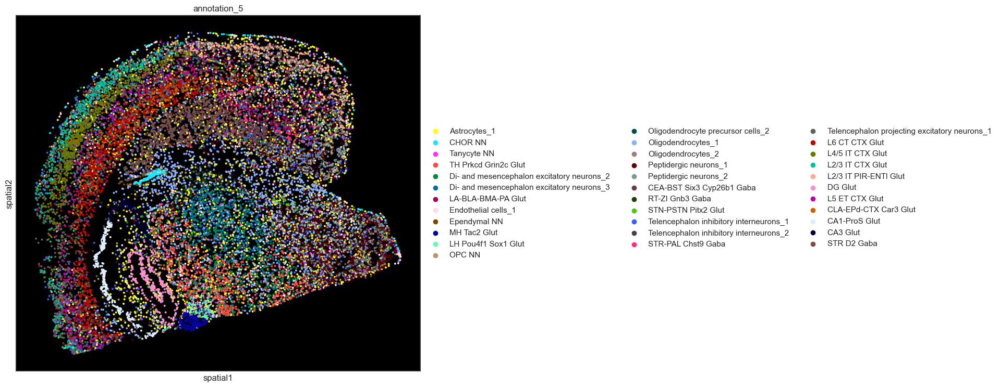

/home/lixinxing/anaconda3/envs/immune/lib/python3.8/site-packages/anndata/_core/anndata.py:1222: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/home/lixinxing/anaconda3/envs/immune/lib/python3.8/site-packages/anndata/_core/anndata.py:1222: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


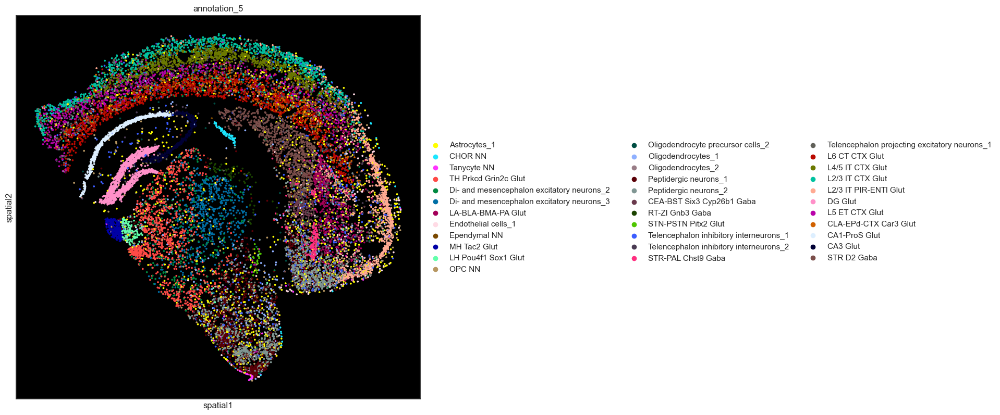

In [45]:
for sample in v2.obs['chip'].unique():
    fig,ax=plt.subplots(figsize=(10,10))
    ax.set_facecolor('black')
    sc.pl.spatial(v2[v2.obs['chip'].isin([sample])], basis='spatial', color=['annotation_5'], spot_size=60, ax=ax)
    plt.rcParams['pdf.fonttype'] = 42
    plt.rcParams['font.sans-serif'] = 'Arial'
    ax.set_facecolor('black')
    # fig.savefig('./annotation_C4_annotation4_2.pdf',bbox_inches='tight')
    plt.show()

In [49]:
v2.write_h5ad('/home/lixinxing/V2/diffusion/celltype/v2_fig_c3_c4.h5ad')

## 10x visium FFPE region annotation

### 1、Load data

In [42]:
import scanpy as sc
import glob
import os

def read_and_process_visium(folder_path):
    count_file = glob.glob(os.path.join(folder_path, "filtered_feature_bc_matrix.h5"))[0]
    sample_label = os.path.basename(folder_path.strip('/'))
    
    adata = sc.read_visium(folder_path, count_file=count_file)
    adata.obs['sample'] = sample_label
    adata.var_names_make_unique()
    adata.obs_names = sample_label + '_' + adata.obs_names
    
    return adata

root_path = "/home/lee/project/v2/mouse_brain/10x_visum/"
dataset_folders = glob.glob(os.path.join(root_path, "*/")) 
adata_list = [read_and_process_visium(folder) for folder in dataset_folders]

reading /home/lee/project/v2/mouse_brain/10x_visum/V1_Adult_Mouse_Brain/filtered_feature_bc_matrix.h5
 (0:00:00)


/home/lee/miniconda3/envs/rapids/lib/python3.10/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


reading /home/lee/project/v2/mouse_brain/10x_visum/CytAssist_FFPE_Mouse_Brain_Rep1/filtered_feature_bc_matrix.h5


/home/lee/miniconda3/envs/rapids/lib/python3.10/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


 (0:00:00)


/home/lee/miniconda3/envs/rapids/lib/python3.10/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/lee/miniconda3/envs/rapids/lib/python3.10/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


reading /home/lee/project/v2/mouse_brain/10x_visum/Visium_Fresh_Frozen_Adult_Mouse_Brain/filtered_feature_bc_matrix.h5
 (0:00:00)


/home/lee/miniconda3/envs/rapids/lib/python3.10/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/lee/miniconda3/envs/rapids/lib/python3.10/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


reading /home/lee/project/v2/mouse_brain/10x_visum/CytAssist_FFPE_Mouse_Brain_Rep2/filtered_feature_bc_matrix.h5
 (0:00:00)


/home/lee/miniconda3/envs/rapids/lib/python3.10/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/lee/miniconda3/envs/rapids/lib/python3.10/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [49]:
tmp=adata_list[2]
spatial_coords = tmp.obsm['spatial']
x_max = np.max(spatial_coords[:, 0])
x_min = np.min(spatial_coords[:, 0])
width = x_max - x_min
spatial_coords[:, 0] = x_max - spatial_coords[:, 0]
tmp.obsm['spatial'] = spatial_coords
adata_list[2]=tmp

In [50]:
adata = sc.concat(adata_list, join='outer')
adata

AnnData object with n_obs × n_vars = 10044 × 32285
    obs: 'in_tissue', 'array_row', 'array_col', 'sample'
    obsm: 'spatial'

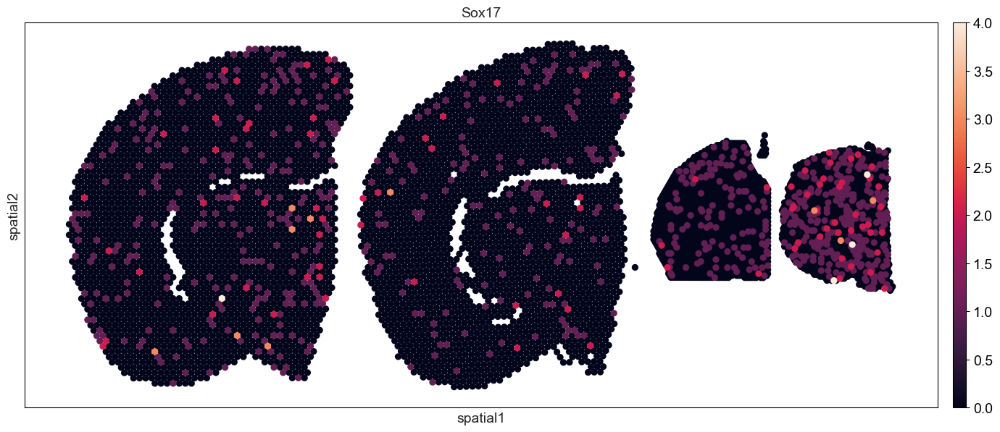

In [51]:
reloc(adata)
with rc_context(rc={'figure.figsize': (28, 7)}):
    sc.pl.spatial(adata, color='Sox17', spot_size=400)

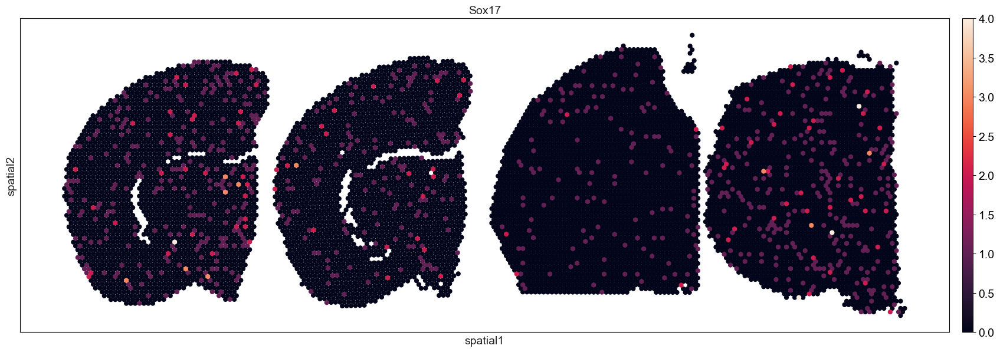

In [11]:
adata.obsm['spatial'][adata.obs['sample'].isin(['adult', 'fresh'])] *= 2.5

reloc(adata)
with rc_context(rc={'figure.figsize': (28, 7)}):
    sc.pl.spatial(adata, color='Sox17', spot_size=400)

In [12]:
adata.write_h5ad('/home/lixinxing/V2/FFPE_4/ffpe_raw.h5ad')

### 2、Batch correction

In [52]:
adata.obs['sample'].unique()

['V1_Adult_Mouse_Brain', 'CytAssist_FFPE_Mouse_Brain_Rep1', 'Visium_Fresh_Frozen_Adult_Mouse_Brain', 'CytAssist_FFPE_Mouse_Brain_Rep2']
Categories (4, object): ['CytAssist_FFPE_Mouse_Brain_Rep1', 'CytAssist_FFPE_Mouse_Brain_Rep2', 'V1_Adult_Mouse_Brain', 'Visium_Fresh_Frozen_Adult_Mouse_Brain']

In [224]:
import os
import anndata as ad
import warnings
import scanpy as sc
import torch
import scarches as sca
from scarches.dataset.trvae.data_handling import remove_sparsity
import matplotlib.pyplot as plt
import numpy as np
import gdown
import sys
import re
import matplotlib.pyplot as plt
import scanpy.external as sce
import pandas as pd
import gc
sc.settings.set_figure_params(dpi=200, frameon=False)
sc.set_figure_params(dpi=200)
sc.set_figure_params(figsize=(10, 10))
torch.set_printoptions(precision=3, sci_mode=False, edgeitems=7)

#################################################################### SCVI ####################################################
condition_key = 'sample'
adata = sc.read_h5ad('/home/lixinxing/V2/FFPE_4/ffpe_raw.h5ad')

save_path = f'/home/lixinxing/V2/FFPE_4/'
ref_path = os.path.join(save_path,'ref_model')
if not os.path.exists(ref_path):
    os.makedirs(ref_path)
    
adata = remove_sparsity(adata)
#### train
sca.models.SCVI.setup_anndata(adata, batch_key=condition_key)
vae = sca.models.SCVI(
            adata,
            n_layers=2,
            n_latent = 15,
            #encode_covariates=True,
            #deeply_inject_covariates=False,
            use_layer_norm="both",
            use_batch_norm="none",
                                )
vae.train(max_epochs=100)
vae.save(ref_path, overwrite=True)
reference_latent = sc.AnnData(vae.get_latent_representation())
reference_latent.obs = adata.obs.copy()
## save SCVI
reference_latent.write_h5ad(f"{save_path}/scvi.h5ad"),

/home/lee/miniconda3/envs/rapids/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:191: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/lee/miniconda3/envs/rapids/lib/python3.10/site ...
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/lee/miniconda3/envs/rapids/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:191: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/lee/miniconda3/envs/rapids/lib/python3.10/site ...
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/lee/miniconda3/envs/rapids/lib/python3.10/site-packages/lightning/pytorch/trainer/connectors/data_co

Epoch 100/100: 100%|██████████| 100/100 [02:27<00:00,  1.45s/it, v_num=1, train_loss_step=1.33e+4, train_loss_epoch=1.31e+4]

`Trainer.fit` stopped: `max_epochs=100` reached.


Epoch 100/100: 100%|██████████| 100/100 [02:27<00:00,  1.48s/it, v_num=1, train_loss_step=1.33e+4, train_loss_epoch=1.31e+4]


(None,)

### 3、Dimensionality reduction and clustering

In [53]:
scvi = sc.read_h5ad("/home/lixinxing/V2/FFPE_4/scvi.h5ad")
adata = sc.read_h5ad('/home/lixinxing/V2/FFPE_4/ffpe_raw.h5ad')
adata.obsm['X_pca_scvi'] = scvi.X
adata

AnnData object with n_obs × n_vars = 10044 × 32285
    obs: 'in_tissue', 'array_row', 'array_col', 'sample'
    obsm: 'X_umap', 'spatial', 'X_pca_scvi'

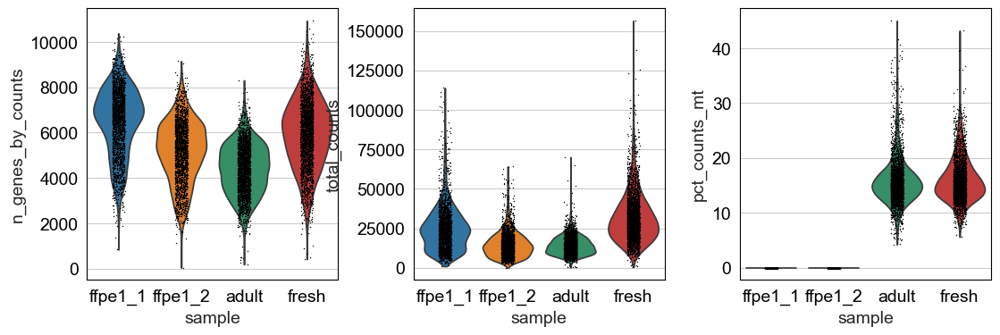

In [54]:
sc_qc(adata, sc_filter=False)
sc.pl.violin(adata, groupby='sample', keys=['n_genes_by_counts', 'total_counts', 'pct_counts_mt'])

normalizing counts per cell
    finished (0:00:02)
extracting highly variable genes
    finished (0:00:08)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


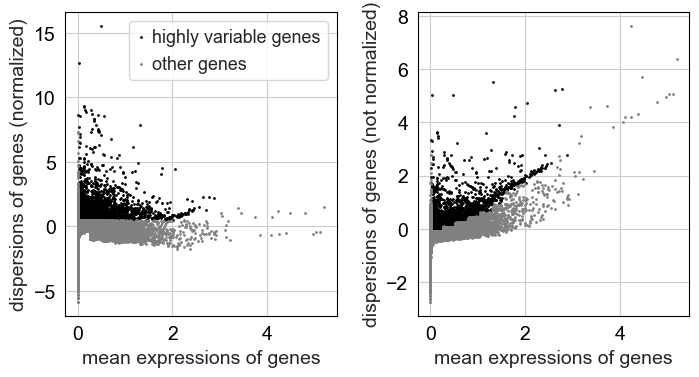

/home/lee/miniconda3/envs/rapids/lib/python3.10/site-packages/scanpy/preprocessing/_simple.py:961: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing PCA
    with n_comps=50
    finished (0:00:11)


In [55]:
adata.layers['counts'] = adata.X.copy()
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)

sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)
sc.pl.highly_variable_genes(adata)
adata.raw = adata
adata = del_mt_rp(adata)
adata = adata[:, adata.var['highly_variable']]
sc.pp.scale(adata)
sc.pp.pca(adata)

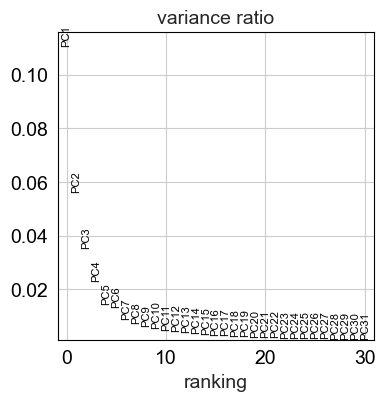

In [56]:
sc.pl.pca_variance_ratio(adata)

### 4、Region annotation

computing neighbors
    finished: added to `.uns['top_region_cluster_0.9']`
    `.obsp['top_region_cluster_0.9_distances']`, distances for each pair of neighbors
    `.obsp['top_region_cluster_0.9_connectivities']`, weighted adjacency matrix (0:00:02)
running Leiden clustering
    finished: found 26 clusters and added
    'top_region_cluster_0.9', the cluster labels (adata.obs, categorical) (0:00:02)


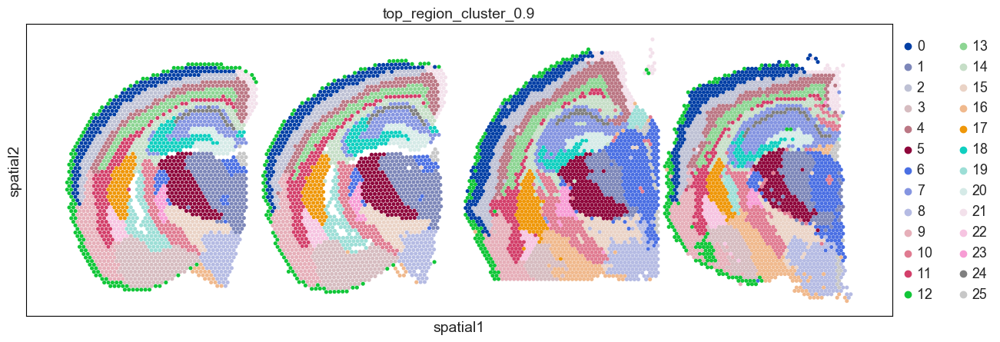

In [259]:
region_key = "top_region_cluster_0.9"
sc.pp.neighbors(tmp, use_rep='X_pca_scvi', key_added=region_key,n_neighbors=22)
sc.tl.leiden(tmp, resolution = 0.9, key_added=region_key, neighbors_key=region_key)

with rc_context(rc={'figure.figsize': (30, 5)}):
    sc.pl.spatial(tmp, color=region_key, basis='spatial', spot_size=350)

computing neighbors
    finished: added to `.uns['top_region_cluster_0.95']`
    `.obsp['top_region_cluster_0.95_distances']`, distances for each pair of neighbors
    `.obsp['top_region_cluster_0.95_connectivities']`, weighted adjacency matrix (0:00:02)
running Leiden clustering
    finished: found 28 clusters and added
    'top_region_cluster_0.95', the cluster labels (adata.obs, categorical) (0:00:04)


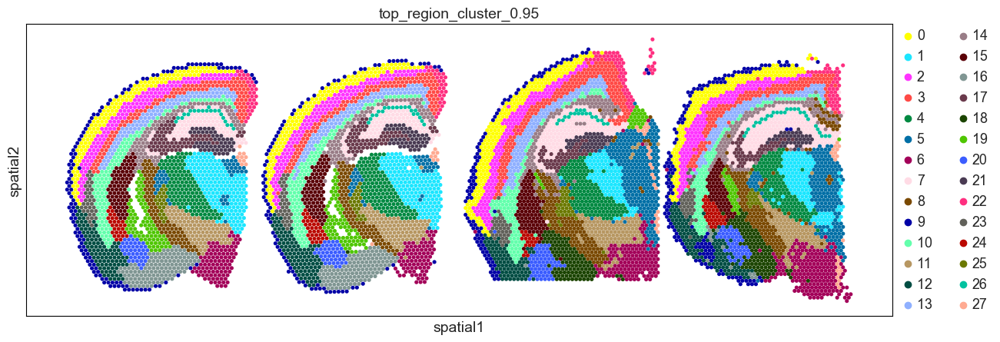

In [272]:
region_key = "top_region_cluster_0.95"  
sc.pp.neighbors(tmp, use_rep='X_pca_scvi', key_added=region_key,n_neighbors=22)
sc.tl.leiden(tmp, resolution = 0.95, key_added=region_key, neighbors_key=region_key)

with rc_context(rc={'figure.figsize': (30, 5)}):
    sc.pl.spatial(tmp, color=region_key, basis='spatial', spot_size=350)

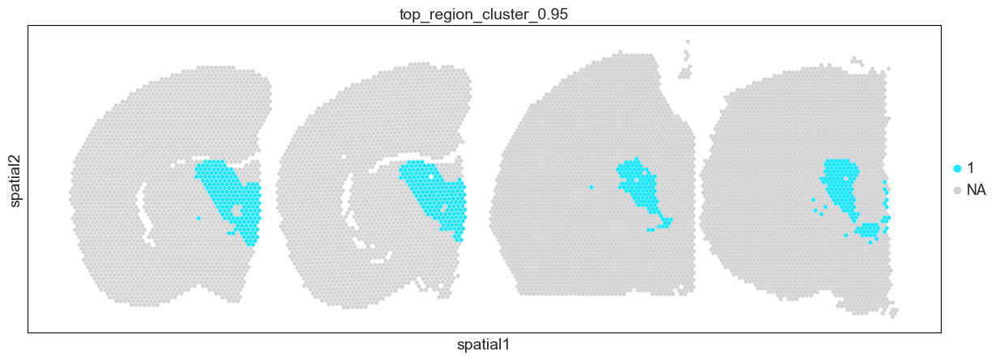

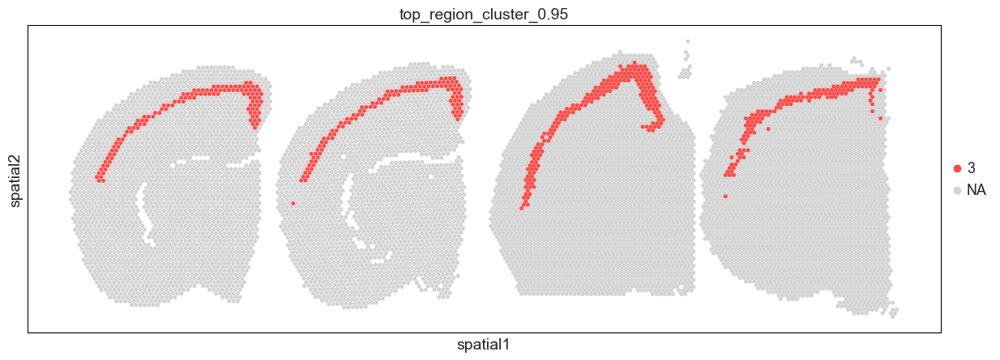

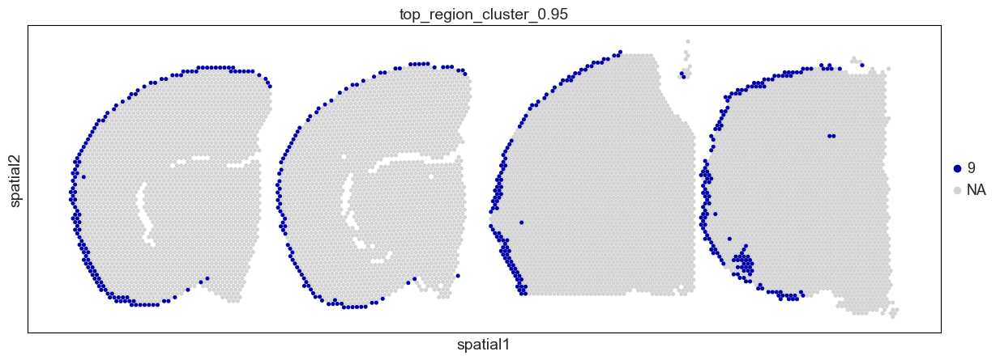

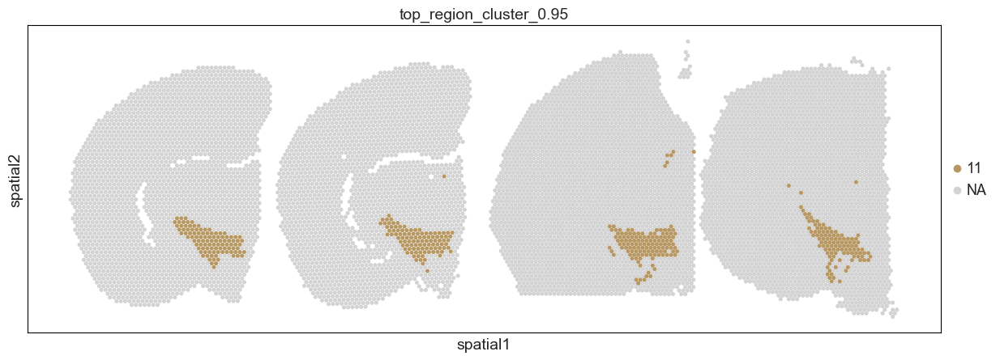

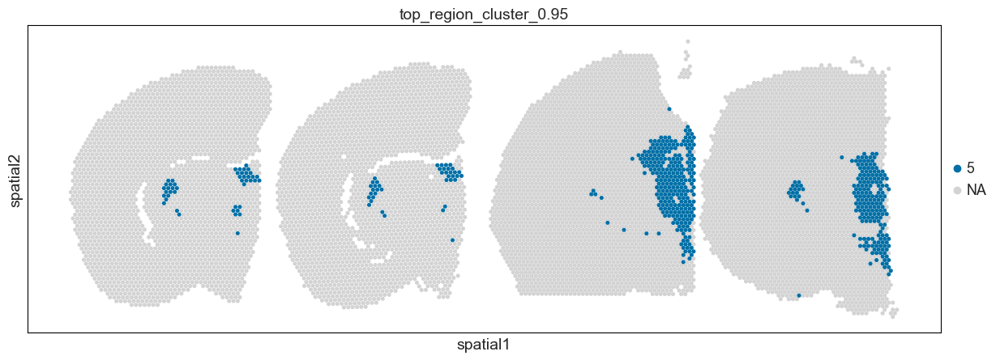

...

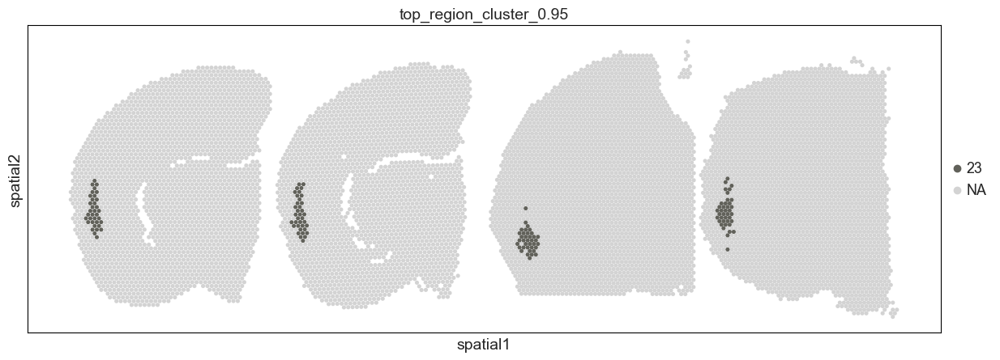

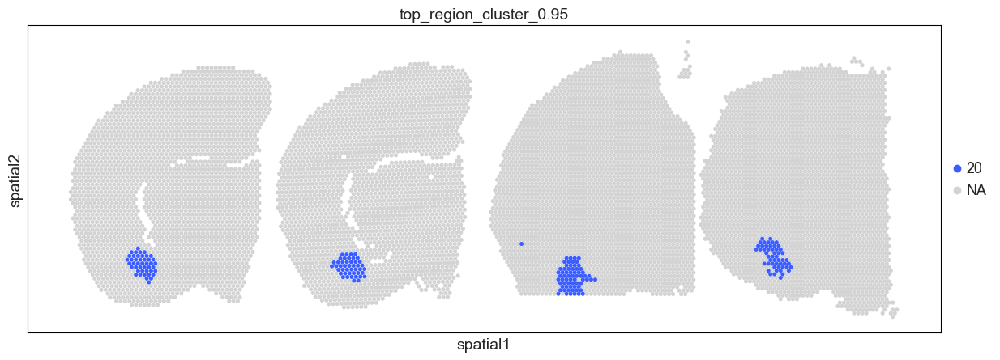

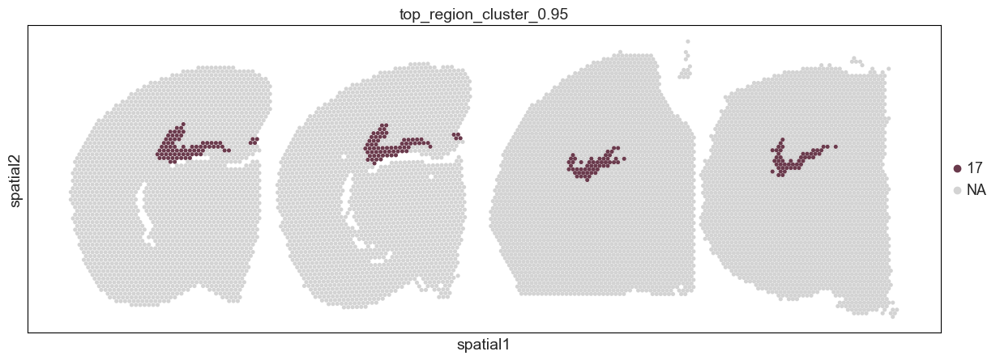

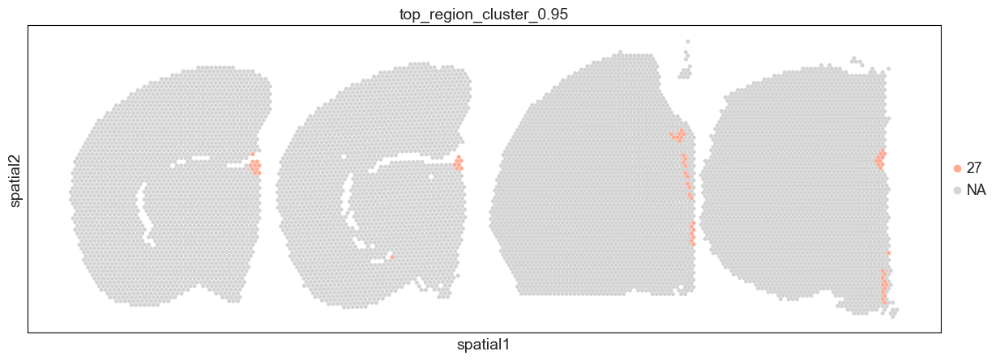

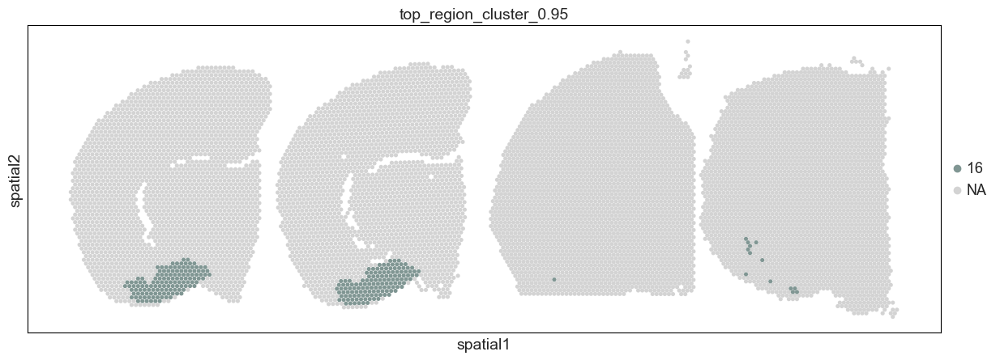

In [273]:
region_key = "top_region_cluster_0.95"  
for leiden in tmp.obs[region_key].unique():
    with rc_context(rc={'figure.figsize': (30, 5)}):
        sc.pl.spatial(tmp, color=region_key, basis='spatial', spot_size=350,groups=leiden)

In [287]:
cluster2annotation = {
     '0': 'Cortex L2/3', 
     '1': 'TH', 
     '2': 'Cortex L4', 
     '3': 'Cortex L5',  
     '4':'TH', 
     '5':'TH',  
    '6': 'HY',  
     '7': 'DG', 
     '8':'fi&opt&cpd',  
     '9':'Cortex L1' ,
    '10': 'Cortex L6', 
    '11':'HY',  
    '12':'PIR',
    '13':'Cortex L6',
    '14':'FT',
    '15':'CP',
    '16':'AMY',  # FFPE_1_2
    '17':'CA',
    '18':'AMY', # Fresh_adult
    '19':'VS',
    '20':'AMY',
    '21':'MLDG',
    '22':'Cortex L4',
    '23':'PIR',
    '24':'AMY',
    '25':'HY',
    '26':'CA',
    '27':'MH',
    
}
tmp.obs['region2'] = tmp.obs['top_region_cluster_0.95'].map(cluster2annotation).astype('category')
# sc.pl.spatial(tmp, color='region', basis='spatial', spot_size=350,palette='tab20')

In [15]:
tmp.obs['region2']=pd.Categorical(tmp.obs['region2'],categories=['TH',
  'HY',                                                                
 'Cortex L1',
 'Cortex L5',
 'Cortex L4',
 'fi&opt&cpd',
 'DG',
 'AMY',
 'FT',
 'Cortex L6',
 'CP',
 'VL',
 'PIR',
 'Cortex L2/3',
 'MLDG',
 'CA',
 'MH'],ordered=True)

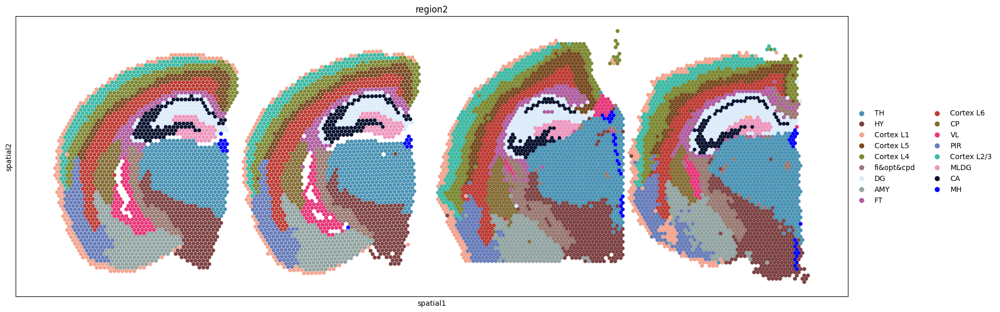

In [4]:
color=['#4a93b4','#7d4243','#f3a58f','#774a21','#7d8832','#987870','#dbebf9','#92a4a1','#b05da1','#bc3c34','#856e37','#e73679','#677cb9','#3fb9a4','#ee97be','#0b122e','blue']
with rc_context(rc={'figure.figsize': (30, 7)}):
    sc.pl.spatial(tmp, color='region2', basis='spatial', spot_size=360,palette=color)

In [17]:
tmp.write_h5ad('./FFPE_4/ffpe_scvi.h5ad')  # top_region_cluster_0.9+top_region_cluster_0.95

# Fig3 E

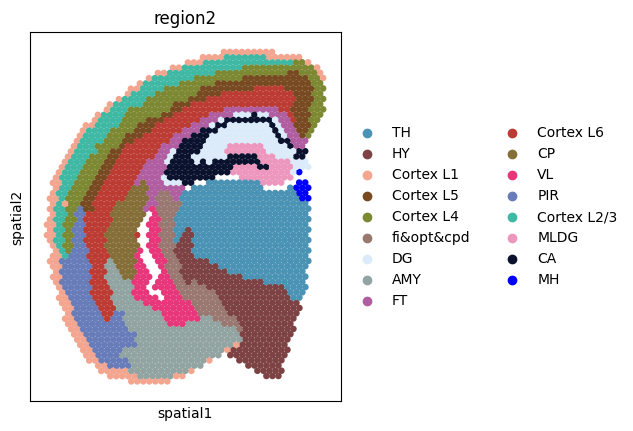

In [5]:
adata=tmp[tmp.obs['sample'].isin(['ffpe1_1'])].copy()
sc.pl.spatial(adata,color='region2',spot_size=400)

## AMY region

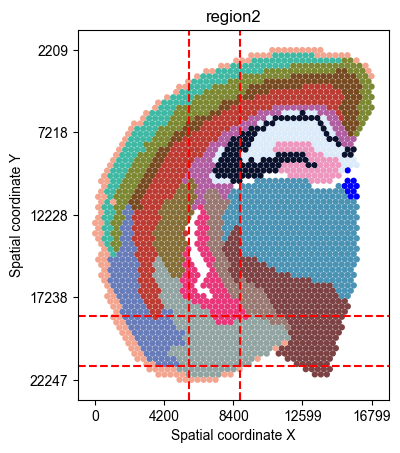

In [147]:
xmin=5700
xmax=8700
ymin=18400
ymax=21400

axs = sc.pl.spatial(adata, basis='spatial', color=['region2'], spot_size=380,legend_loc=None,show=False)

for ax in axs:
    ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)
    ax.set_xlabel('Spatial coordinate X')
    ax.set_ylabel('Spatial coordinate Y')


    ax.axvline(x=xmin, color='red', linestyle='--') 
    ax.axvline(x=xmax, color='red', linestyle='--')
    
    ax.axhline(y=ymin, color='red', linestyle='--') 
    ax.axhline(y=ymax, color='red', linestyle='--') 

    spatial_coords = adata.obsm['spatial']
    ax.set_xticks(np.linspace(spatial_coords[:, 0].min(), spatial_coords[:, 0].max(), num=5))
    ax.set_yticks(np.linspace(spatial_coords[:, 1].min(), spatial_coords[:, 1].max(), num=5))

plt.show()

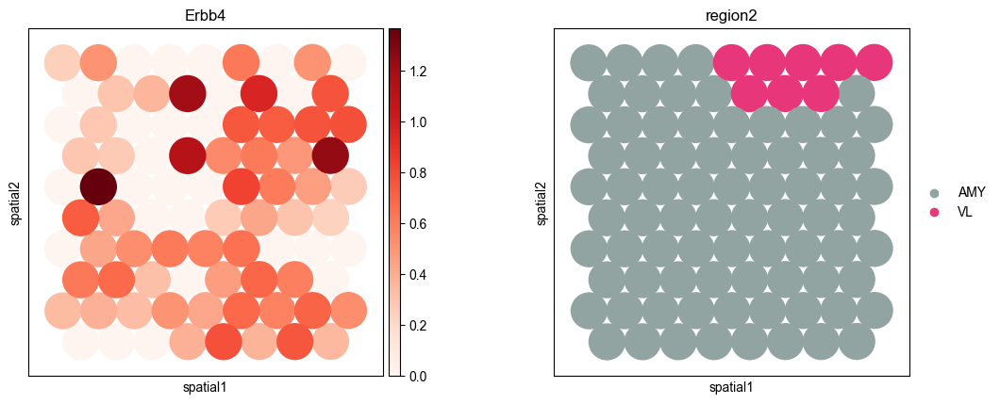

In [148]:
v1=adata
roi_ffpe_vl = v1[(v1.obsm['spatial'][:, 0] > xmin) & (v1.obsm['spatial'][:, 0] < xmax) & 
            (v1.obsm['spatial'][:, 1] > ymin) & (v1.obsm['spatial'][:, 1] < ymax)]

sc.pl.spatial(roi_ffpe_vl, basis='spatial', color=['Erbb4','region2'],spot_size=380,cmap='Reds')

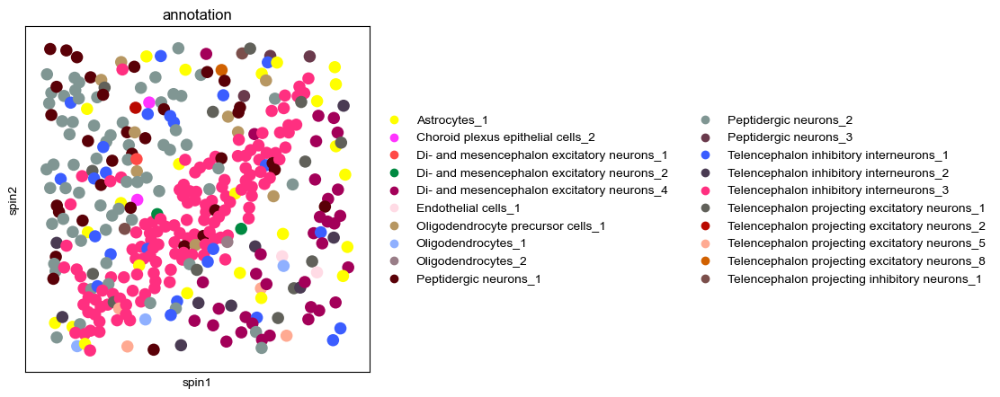

In [29]:
xmin=1900
xmax=2900
ymin=10000
ymax=11000

fig,ax=plt.subplots(figsize=(5,5))
plt.rcParams['figure.facecolor'] = 'white'
plt.rcParams['axes.facecolor'] = 'white'

v1=v2
roi_vl = v1[(v1.obsm['spin'][:, 0] > xmin) & (v1.obsm['spin'][:, 0] < xmax) & 
            (v1.obsm['spin'][:, 1] > ymin) & (v1.obsm['spin'][:, 1] < ymax)]

sc.pl.spatial(roi_vl, basis='spin', color=['annotation'],spot_size=40,edges_color='white',edges_width=20,ax=ax)
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['font.sans-serif'] = 'Arial'
ax.set_facecolor('white')

#fig.savefig('./sub_VL.pdf')
plt.show()

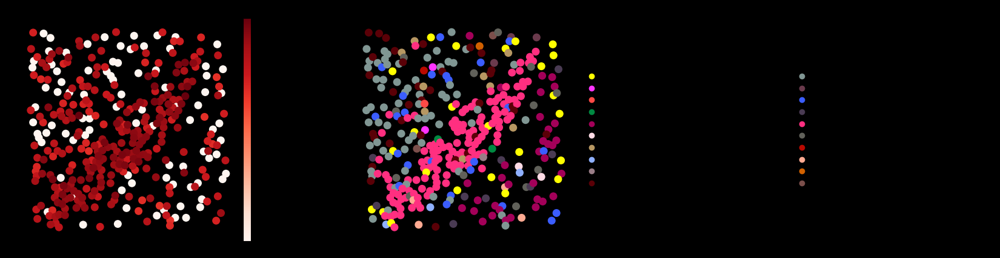

In [43]:
plt.rcParams['figure.facecolor'] = 'black'
plt.rcParams['axes.facecolor'] = 'black'
sc.pl.spatial(roi_vl, basis='spin', color=['Erbb4','annotation'],spot_size=40,cmap='Reds')

In [67]:
vl=roi_vl.obs['annotation'].unique()
adata_VL = v2[v2.obs['annotation'].isin(vl)]

In [69]:
sc.pp.log1p(adata_VL)
sc.tl.rank_genes_groups(adata_VL, 'annotation', method='t-test')
# sc.pl.rank_genes_groups(adata_VL, n_genes=25, sharey=False)
df=pd.DataFrame(adata_VL.uns['rank_genes_groups']['names']).head(5)

/home/lixinxing/anaconda3/envs/immune/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:373: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


In [69]:
sc.pp.log1p(adata_VL)
sc.tl.rank_genes_groups(adata_VL, 'annotation', method='t-test')
# sc.pl.rank_genes_groups(adata_VL, n_genes=25, sharey=False)
df=pd.DataFrame(adata_VL.uns['rank_genes_groups']['names']).head(5)

/home/lixinxing/anaconda3/envs/immune/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:373: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


/home/lixinxing/anaconda3/envs/immune/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


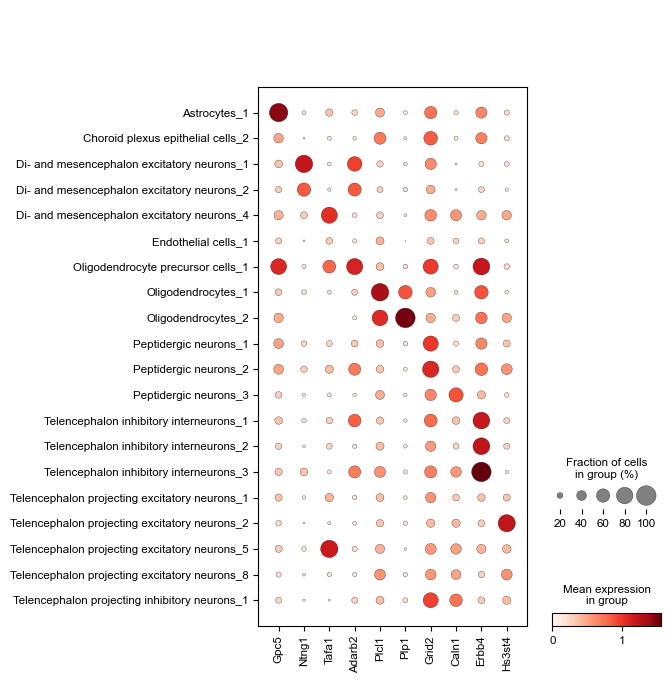

In [70]:
sc.pl.dotplot(adata_VL,var_names=['Gpc5','Ntng1','Tafa1','Adarb2','Plcl1','Plp1','Grid2','Caln1','Erbb4','Hs3st4'], groupby='annotation',cmap='Reds')

## PIR region

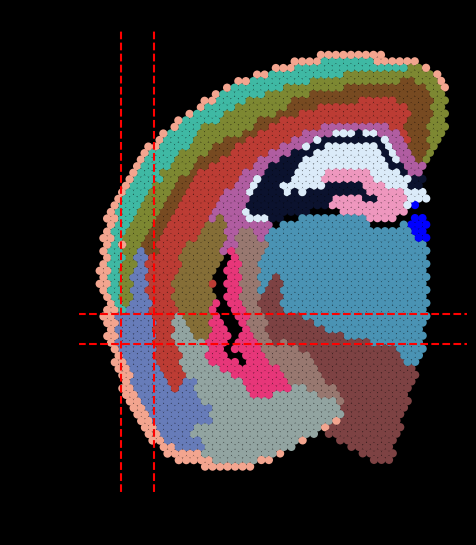

In [219]:
xmin=730+300
xmax=xmin+1500
ymin=12400+2400
ymax=ymin+1500

fig,ax=plt.subplots(figsize=(8,6))
axs = sc.pl.spatial(adata, basis='spatial', color=['region2'], spot_size=400,legend_loc=None,show=False,ax=ax)

for ax in axs:
    ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)
    ax.set_xlabel('Spatial coordinate X')
    ax.set_ylabel('Spatial coordinate Y')


    ax.axvline(x=xmin, color='red', linestyle='--') 
    ax.axvline(x=xmax, color='red', linestyle='--')
    
    ax.axhline(y=ymin, color='red', linestyle='--') 
    ax.axhline(y=ymax, color='red', linestyle='--') 

    spatial_coords = adata.obsm['spatial']
    ax.set_xticks(np.linspace(spatial_coords[:, 0].min(), spatial_coords[:, 0].max(), num=5))
    ax.set_yticks(np.linspace(spatial_coords[:, 1].min(), spatial_coords[:, 1].max(), num=5))

plt.show()

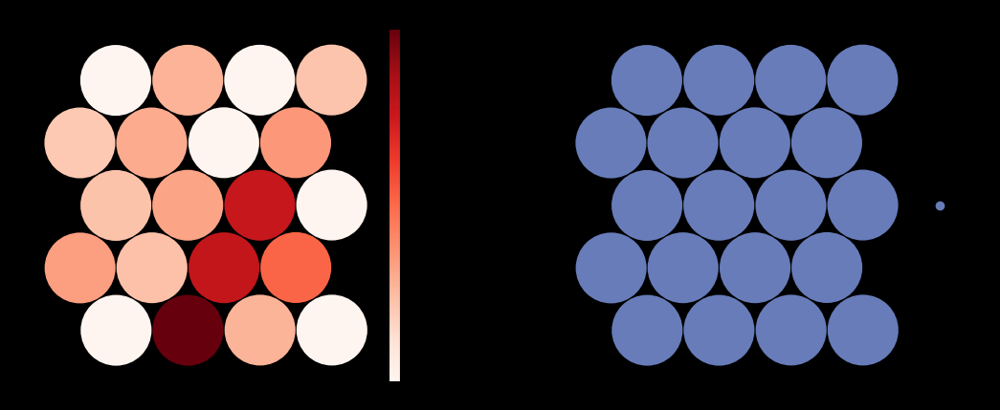

In [249]:
v1=adata
roi_ffpe_vl = v1[(v1.obsm['spatial'][:, 0] > xmin) & (v1.obsm['spatial'][:, 0] < xmax) & 
            (v1.obsm['spatial'][:, 1] > ymin) & (v1.obsm['spatial'][:, 1] < ymax)]

sc.pl.spatial(roi_ffpe_vl, basis='spatial', color=['Erbb4','region2'],spot_size=360,cmap='Reds')


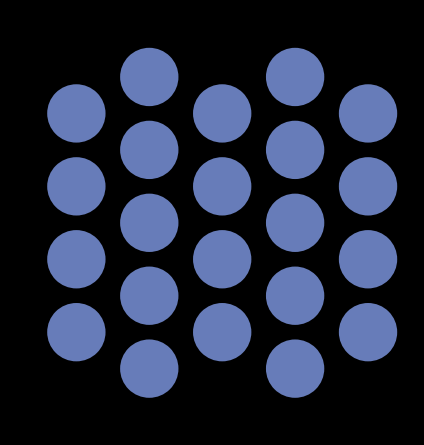

In [253]:
xmin=4150
xmax=4650
ymin=4900
ymax=5400

fig,ax=plt.subplots(figsize=(5,5))
plt.rcParams['figure.facecolor'] = 'black'
plt.rcParams['axes.facecolor'] = 'black'

v1=adata_fig
roi_ffpe_pir = v1[(v1.obsm['physical_coords'][:, 0] > xmin) & (v1.obsm['physical_coords'][:, 0] < xmax) & 
            (v1.obsm['physical_coords'][:, 1] > ymin) & (v1.obsm['physical_coords'][:, 1] < ymax)]

sc.pl.spatial(roi_ffpe_pir, basis='physical_coords', color=['leiden'],spot_size=80,ax=ax,legend_loc=None)
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['font.sans-serif'] = 'Arial'
ax.set_facecolor('black')

plt.show()

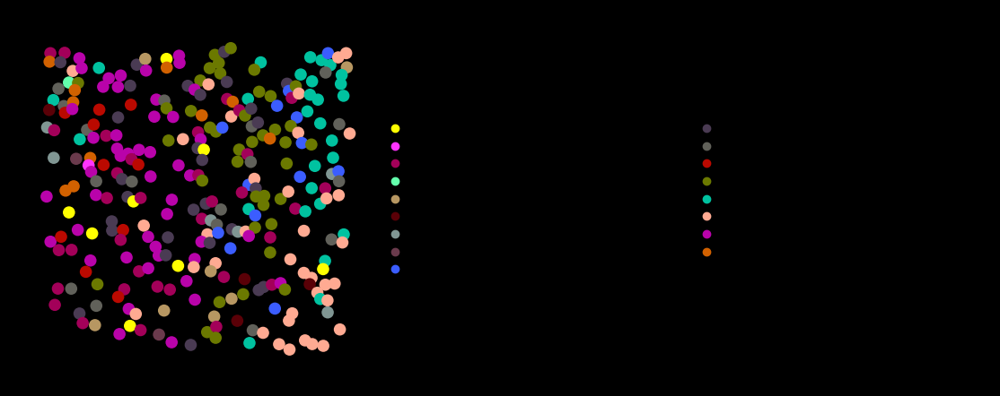

In [83]:
xmin=5000
xmax=6000
ymin=7500
ymax=8500

fig,ax=plt.subplots(figsize=(5,5))
plt.rcParams['figure.facecolor'] = 'black'
plt.rcParams['axes.facecolor'] = 'black'

v1=v2
roi_pir = v1[(v1.obsm['spin'][:, 0] > xmin) & (v1.obsm['spin'][:, 0] < xmax) & 
            (v1.obsm['spin'][:, 1] > ymin) & (v1.obsm['spin'][:, 1] < ymax)]

sc.pl.spatial(roi_pir, basis='spin', color=['annotation'],spot_size=40,edges_color='white',edges_width=20,ax=ax)
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['font.sans-serif'] = 'Arial'
ax.set_facecolor('black')

#fig.savefig('./sub_CTX.pdf')
plt.show()

In [85]:
pir=roi_pir.obs['annotation'].unique()
adata_pir = v2[v2.obs['annotation'].isin(pir)]

sc.pp.log1p(adata_pir)
sc.tl.rank_genes_groups(adata_pir, 'annotation', method='t-test')
# sc.pl.rank_genes_groups(adata_VL, n_genes=25, sharey=False)
df=pd.DataFrame(adata_pir.uns['rank_genes_groups']['names']).head(5)

/home/lixinxing/anaconda3/envs/immune/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


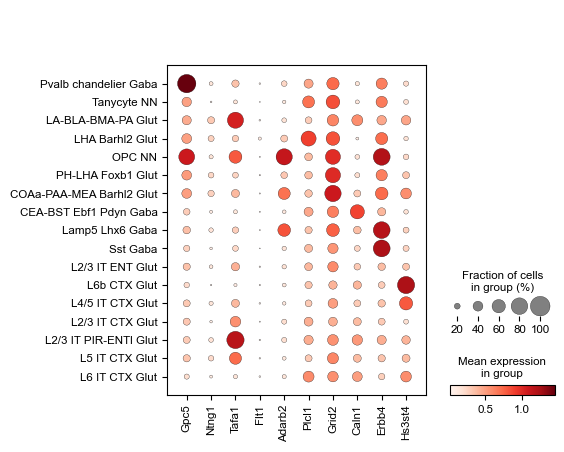

In [87]:
fig,ax=plt.subplots(figsize=(5,5))
plt.rcParams['figure.facecolor'] = 'white'
plt.rcParams['axes.facecolor'] = 'white'

sc.pl.dotplot(adata_pir,var_names=['Gpc5','Ntng1','Tafa1','Flt1','Adarb2','Plcl1','Grid2','Caln1','Erbb4','Hs3st4'], groupby='annotation_3',cmap='Reds',ax=ax)

plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['font.sans-serif'] = 'Arial'
ax.set_facecolor('white')

# fig.savefig('../celltype/annotation3_dotplot_pir.pdf')
plt.show()

## HY region

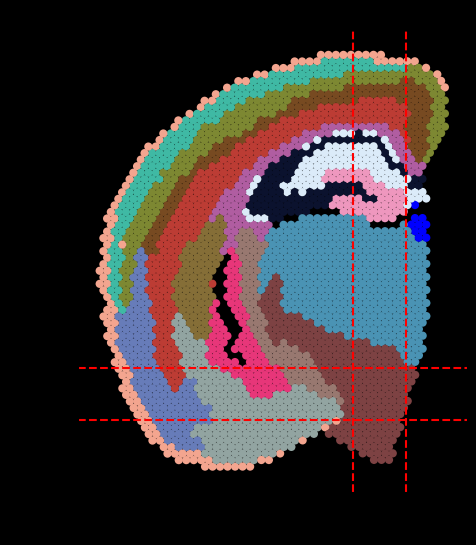

In [243]:
xmin=12329
xmax=14929
ymin=17460
ymax=19960

fig,ax=plt.subplots(figsize=(8,6))
axs = sc.pl.spatial(adata, basis='spatial', color=['region2'], spot_size=400,legend_loc=None,show=False,ax=ax)

for ax in axs:
    ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)
    ax.set_xlabel('Spatial coordinate X')
    ax.set_ylabel('Spatial coordinate Y')


    ax.axvline(x=xmin, color='red', linestyle='--') 
    ax.axvline(x=xmax, color='red', linestyle='--')
    
    ax.axhline(y=ymin, color='red', linestyle='--') 
    ax.axhline(y=ymax, color='red', linestyle='--') 

    spatial_coords = adata.obsm['spatial']
    ax.set_xticks(np.linspace(spatial_coords[:, 0].min(), spatial_coords[:, 0].max(), num=5))
    ax.set_yticks(np.linspace(spatial_coords[:, 1].min(), spatial_coords[:, 1].max(), num=5))

plt.show()

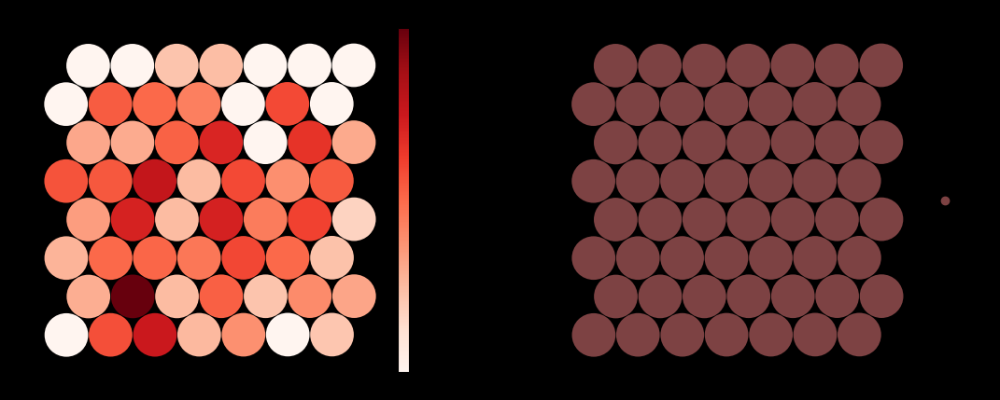

In [244]:
v1=adata
roi_ffpe_vl = v1[(v1.obsm['spatial'][:, 0] > xmin) & (v1.obsm['spatial'][:, 0] < xmax) & 
            (v1.obsm['spatial'][:, 1] > ymin) & (v1.obsm['spatial'][:, 1] < ymax)]

sc.pl.spatial(roi_ffpe_vl, basis='spatial', color=['Erbb4','region2'],spot_size=360,cmap='Reds')


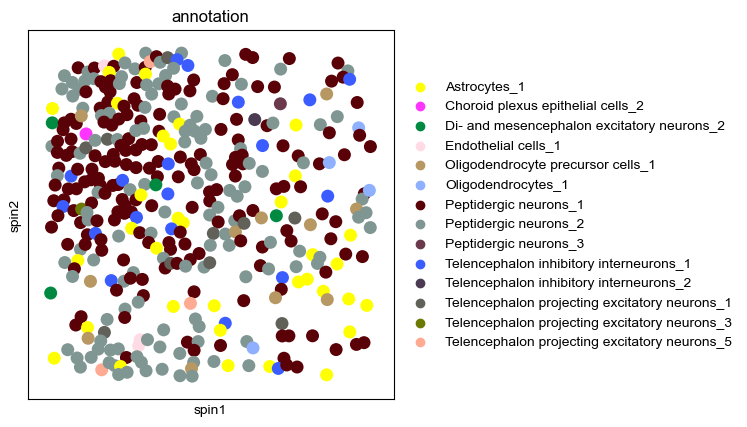

In [93]:
xmin=-1800
xmax=-800
ymin=10700
ymax=11700

v1=v2
roi_hy = v1[(v1.obsm['spin'][:, 0] > xmin) & (v1.obsm['spin'][:, 0] < xmax) & 
            (v1.obsm['spin'][:, 1] > ymin) & (v1.obsm['spin'][:, 1] < ymax)]

sc.pl.spatial(roi_hy, basis='spin', color=['annotation'],spot_size=40,edges_color='white',edges_width=20)
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['font.sans-serif'] = 'Arial'
ax.set_facecolor('black')

#fig.savefig('./sub_CTX.pdf')
plt.show()

In [90]:
hy=roi_hy.obs['annotation'].unique()
adata_hy = v2[v2.obs['annotation'].isin(hy)]

sc.pp.log1p(adata_hy)
sc.tl.rank_genes_groups(adata_hy, 'annotation', method='t-test')
# sc.pl.rank_genes_groups(adata_hy, n_genes=25, sharey=False)
df=pd.DataFrame(adata_hy.uns['rank_genes_groups']['names']).head(5)

/home/lixinxing/anaconda3/envs/immune/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:373: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


/home/lixinxing/anaconda3/envs/immune/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


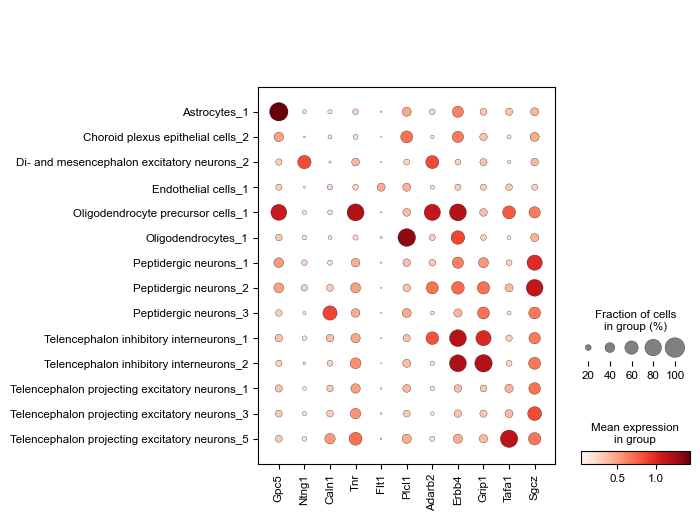

In [95]:
sc.pl.dotplot(adata_hy,var_names=['Gpc5','Ntng1','Caln1','Tnr','Flt1','Plcl1','Adarb2','Erbb4','Grip1','Tafa1','Sgcz'], groupby='annotation',cmap='Reds')